# 15-1. 프로젝트 : 스티커를 붙여주자

In [1]:
import tensorflow as tf
import numpy as np
import cv2

print(tf.__version__)
print(np.__version__)
print(cv2.__version__)

2.6.0
1.21.4
4.5.3


In [2]:
import os, time
import tqdm
import math
from itertools import product
import matplotlib.pyplot as plt

### Step 1. 스티커 구하기 혹은 만들기
---
왕관 또는 고양이 수염 등을 구하거나 혹은 다양한 아이디어의 스티커를 만들어 볼 수 있을 것입니다.

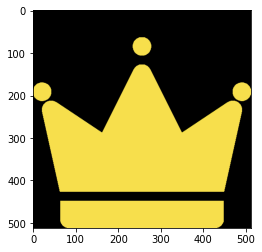

In [3]:
# 왕관 스티커 이미지 불러오기
sticker_path = os.getenv('HOME') + '/aiffel/camera_sticker/images/king.png'
img_sticker = cv2.imread(sticker_path, cv2.IMREAD_UNCHANGED)
plt.imshow(cv2.cvtColor(img_sticker, cv2.COLOR_BGR2RGB))

### Step 2. SSD 모델을 통해 얼굴 bounding box 찾기
---
우리는 실습 코드를 진행하며 필요한 모델을 이미 생성해 왔을 것입니다. 잘 훈련된 해당 모델을 통해 적절한 얼굴 bounding box를 찾아내 봅시다. inference.py 코드를 적극적으로 참고해 보시기를 권합니다.

#### WIDER FACE Bounding Box

In [4]:
PROJECT_PATH = os.getenv('HOME')+'/aiffel/face_detector'
DATA_PATH = os.path.join(PROJECT_PATH, 'widerface')
MODEL_PATH = os.path.join(PROJECT_PATH, 'checkpoints')
TRAIN_TFRECORD_PATH = os.path.join(PROJECT_PATH, 'dataset', 'train_mask.tfrecord')
VALID_TFRECORD_PATH = os.path.join(PROJECT_PATH, 'dataset', 'val_mask.tfrecord')
CHECKPOINT_PATH = os.path.join(PROJECT_PATH, 'checkpoints')

DATASET_LEN = 12880
BATCH_SIZE = 32
IMAGE_WIDTH = 320
IMAGE_HEIGHT = 256
IMAGE_LABELS = ['background', 'face']

In [5]:
def parse_box(data):
    x0 = int(data[0])
    y0 = int(data[1])
    w = int(data[2])
    h = int(data[3])
    return x0, y0, w, h

In [6]:
def parse_widerface(file):
    infos = []
    with open(file) as fp:
        line = fp.readline()
        while line:
            n_object = int(fp.readline())
            boxes = []
            for i in range(n_object):
                box = fp.readline().split(' ')
                x0, y0, w, h = parse_box(box)
                if (w == 0) or (h == 0):
                    continue
                boxes.append([x0, y0, w, h])
            if n_object == 0:
                box = fp.readline().split(' ')
                x0, y0, w, h = parse_box(box)
                boxes.append([x0, y0, w, h])
            infos.append((line.strip(), boxes))
            line = fp.readline()
    return infos

위 함수는 이미지별 bounding box 정보를 wider_face_train_bbx_gt.txt에서 파싱해서 리스트로 추출하는 것입니다.

이제 추출된 정보를 실제 이미지 정보와 결합합니다. bounding box 정보는 [x, y, w, h] 형태로 저장되어 있는데, [x_min, y_min, x_max, y_max] 형태의 꼭짓점 좌표 정보로 변환할 거예요.

이렇게 정보를 결합해야 나중에 학습에 사용하기 좋습니다.

In [7]:
def process_image(image_file):
    image_string = tf.io.read_file(image_file)
    try:
        image_data = tf.image.decode_jpeg(image_string, channels=3)
        return 0, image_string, image_data
    except tf.errors.InvalidArgumentError:
        return 1, image_string, None

In [8]:
def xywh_to_voc(file_name, boxes, image_data):
    shape = image_data.shape
    image_info = {}
    image_info['filename'] = file_name
    image_info['width'] = shape[1]
    image_info['height'] = shape[0]
    image_info['depth'] = 3

    difficult = []
    classes = []
    xmin, ymin, xmax, ymax = [], [], [], []

    for box in boxes:
        classes.append(1)
        difficult.append(0)
        xmin.append(box[0])
        ymin.append(box[1])
        xmax.append(box[0] + box[2])
        ymax.append(box[1] + box[3])
    image_info['class'] = classes
    image_info['xmin'] = xmin
    image_info['ymin'] = ymin
    image_info['xmax'] = xmax
    image_info['ymax'] = ymax
    image_info['difficult'] = difficult

    return image_info

In [9]:
file_path = os.path.join(DATA_PATH, 'wider_face_split', 'wider_face_train_bbx_gt.txt')
for i, info in enumerate(parse_widerface(file_path)):
    print('--------------------')
    image_file = os.path.join(DATA_PATH, 'WIDER_train', 'images', info[0])
    _, image_string, image_data = process_image(image_file)
    boxes = xywh_to_voc(image_file, info[1], image_data)
    print(boxes)
    if i > 3:
        break

--------------------
{'filename': '/aiffel/aiffel/face_detector/widerface/WIDER_train/images/0--Parade/0_Parade_marchingband_1_849.jpg', 'width': 1024, 'height': 1385, 'depth': 3, 'class': [1], 'xmin': [449], 'ymin': [330], 'xmax': [571], 'ymax': [479], 'difficult': [0]}
--------------------
{'filename': '/aiffel/aiffel/face_detector/widerface/WIDER_train/images/0--Parade/0_Parade_Parade_0_904.jpg', 'width': 1024, 'height': 1432, 'depth': 3, 'class': [1], 'xmin': [361], 'ymin': [98], 'xmax': [624], 'ymax': [437], 'difficult': [0]}
--------------------
{'filename': '/aiffel/aiffel/face_detector/widerface/WIDER_train/images/0--Parade/0_Parade_marchingband_1_799.jpg', 'width': 1024, 'height': 768, 'depth': 3, 'class': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], 'xmin': [78, 78, 113, 134, 163, 201, 182, 245, 304, 328, 389, 406, 436, 522, 643, 653, 793, 535, 29, 3, 20], 'ymin': [221, 238, 212, 260, 250, 218, 266, 279, 265, 295, 281, 293, 290, 328, 320, 224, 337, 311, 22

### TFRecord 만들기
---
오늘 다루게 될 대용량 데이터셋의 처리속도 향상을 위해서, 전처리 작업을 통해 TFRecord 데이터셋으로 변환할 필요가 있습니다. TFRecord란 TensorFlow만의 학습 데이터 저장 포맷으로, 이진(binary) 레코드의 시퀀스를 저장합니다. TFRecord 형태의 학습 데이터를 사용하여 모델 학습을 하면 학습 속도가 개선된다는 장점이 있습니다.

TFRecord는 여러 개의 tf.train.Example로 이루어져 있고, 한 개의 tf.train.Example은 여러 개의 tf.train.Feature로 이루어져 있습니다.

데이터의 단위를 이루는 tf.train.Example 인스턴스를 생성하는 메소드는 아래와 같습니다.

In [10]:
def make_example(image_string, image_infos):
    for info in image_infos:
        filename = info['filename']
        width = info['width']
        height = info['height']
        depth = info['depth']
        classes = info['class']
        xmin = info['xmin']
        ymin = info['ymin']
        xmax = info['xmax']
        ymax = info['ymax']

    if isinstance(image_string, type(tf.constant(0))):
        encoded_image = [image_string.numpy()]
    else:
        encoded_image = [image_string]

    base_name = [tf.compat.as_bytes(os.path.basename(filename))]
    
    example = tf.train.Example(features=tf.train.Features(feature={
        'filename':tf.train.Feature(bytes_list=tf.train.BytesList(value=base_name)),
        'height':tf.train.Feature(int64_list=tf.train.Int64List(value=[height])),
        'width':tf.train.Feature(int64_list=tf.train.Int64List(value=[width])),
        'classes':tf.train.Feature(int64_list=tf.train.Int64List(value=classes)),
        'x_mins':tf.train.Feature(float_list=tf.train.FloatList(value=xmin)),
        'y_mins':tf.train.Feature(float_list=tf.train.FloatList(value=ymin)),
        'x_maxes':tf.train.Feature(float_list=tf.train.FloatList(value=xmax)),
        'y_maxes':tf.train.Feature(float_list=tf.train.FloatList(value=ymax)),
        'image_raw':tf.train.Feature(bytes_list=tf.train.BytesList(value=encoded_image))
    }))
    
    return example

In [11]:
for split in ['train', 'val']:
    if split == 'train':
        output_file = TRAIN_TFRECORD_PATH 
        anno_txt = 'wider_face_train_bbx_gt.txt'
        file_path = 'WIDER_train'
    else:
        output_file = VALID_TFRECORD_PATH
        anno_txt = 'wider_face_val_bbx_gt.txt'
        file_path = 'WIDER_val'

    with tf.io.TFRecordWriter(output_file) as writer:
        for info in tqdm.tqdm(parse_widerface(os.path.join(DATA_PATH, 'wider_face_split', anno_txt))):
            image_file = os.path.join(DATA_PATH, file_path, 'images', info[0])
            error, image_string, image_data = process_image(image_file)
            boxes = xywh_to_voc(image_file, info[1], image_data)

            if not error:
                tf_example = make_example(image_string, [boxes])
                writer.write(tf_example.SerializeToString())

100%|██████████| 3226/3226 [00:13<00:00, 232.97it/s]


In [12]:
# 생성된 TFRecord 파일 확인
!ls ~/aiffel/face_detector/dataset

train_mask.tfrecord  val_mask.tfrecord


#### Default boxes

In [13]:
BOX_MIN_SIZES = [[10, 16, 24], [32, 48], [64, 96], [128, 192, 256]]
BOX_STEPS = [8, 16, 32, 64]

In [14]:
image_sizes = (IMAGE_HEIGHT, IMAGE_WIDTH)
min_sizes = BOX_MIN_SIZES
steps= BOX_STEPS

feature_maps = [
    [math.ceil(image_sizes[0] / step), math.ceil(image_sizes[1] / step)]
    for step in steps
]
feature_maps

[[32, 40], [16, 20], [8, 10], [4, 5]]

In [15]:
boxes = []
for k, f in enumerate(feature_maps):
    for i, j in product(range(f[0]), range(f[1])):
        for min_size in min_sizes[k]:
            s_kx = min_size / image_sizes[1]
            s_ky = min_size / image_sizes[0]
            cx = (j + 0.5) * steps[k] / image_sizes[1]
            cy = (i + 0.5) * steps[k] / image_sizes[0]
            boxes += [cx, cy, s_kx, s_ky]

len(boxes)

18800

In [16]:
pretty_boxes = np.asarray(boxes).reshape([-1, 4])
print(pretty_boxes.shape)
print(pretty_boxes)

(4700, 4)
[[0.0125    0.015625  0.03125   0.0390625]
 [0.0125    0.015625  0.05      0.0625   ]
 [0.0125    0.015625  0.075     0.09375  ]
 ...
 [0.9       0.875     0.4       0.5      ]
 [0.9       0.875     0.6       0.75     ]
 [0.9       0.875     0.8       1.       ]]


In [17]:
def default_box():
    image_sizes = (IMAGE_HEIGHT, IMAGE_WIDTH)
    min_sizes = BOX_MIN_SIZES
    steps= BOX_STEPS
    feature_maps = [
        [math.ceil(image_sizes[0] / step), math.ceil(image_sizes[1] / step)]
        for step in steps
    ]
    boxes = []
    for k, f in enumerate(feature_maps):
        for i, j in product(range(f[0]), range(f[1])):
            for min_size in min_sizes[k]:
                s_kx = min_size / image_sizes[1]
                s_ky = min_size / image_sizes[0]
                cx = (j + 0.5) * steps[k] / image_sizes[1]
                cy = (i + 0.5) * steps[k] / image_sizes[0]
                boxes += [cx, cy, s_kx, s_ky]
    boxes = np.asarray(boxes).reshape([-1, 4])
    return boxes

#### SSD model 빌드

In [18]:
def _conv_block(inputs, filters, kernel=(3, 3), strides=(1, 1)):
    block_id = (tf.keras.backend.get_uid())
    if strides == (2, 2):
        x = tf.keras.layers.ZeroPadding2D(padding=((1, 1), (1, 1)), name='conv_pad_%d' % block_id)(inputs)
        x = tf.keras.layers.Conv2D(filters, kernel,
                                   padding='valid',
                                   use_bias=False,
                                   strides=strides,
                                   name='conv_%d' % block_id)(x)
    else:
        x = tf.keras.layers.Conv2D(filters, kernel,
                                   padding='same',
                                   use_bias=False,
                                   strides=strides,
                                   name='conv_%d' % block_id)(inputs)
    
    x = tf.keras.layers.BatchNormalization(name='conv_bn_%d' % block_id)(x)
    return tf.keras.layers.ReLU(name='conv_relu_%d' % block_id)(x)

In [19]:
def _depthwise_conv_block(inputs, filters, strides=(1, 1)):
    block_id = tf.keras.backend.get_uid()
    if strides == (1, 1):
        x = inputs
    else:
        x = tf.keras.layers.ZeroPadding2D(((1, 1), (1, 1)), name='conv_pad_%d' % block_id)(inputs)
    x = tf.keras.layers.DepthwiseConv2D((3, 3),
                                        padding='same' if strides == (1, 1) else 'valid',
                                        strides=strides,
                                        use_bias=False,
                                        name='conv_dw_%d' % block_id)(x)
    x = tf.keras.layers.BatchNormalization(name='conv_dw_%d_bn' % block_id)(x)
    x = tf.keras.layers.ReLU(name='conv_dw_%d_relu' % block_id)(x)
    x = tf.keras.layers.Conv2D(filters, (1, 1),
                               padding='same',
                               use_bias=False,
                               strides=(1, 1),
                               name='conv_pw_%d' % block_id)(x)
    x = tf.keras.layers.BatchNormalization(name='conv_pw_%d_bn' % block_id)(x)
    return tf.keras.layers.ReLU(name='conv_pw_%d_relu' % block_id)(x)

In [20]:
def _branch_block(inputs, filters):
    x = tf.keras.layers.Conv2D(filters, kernel_size=(3, 3), padding='same')(inputs)
    x = tf.keras.layers.LeakyReLU()(x)
    x = tf.keras.layers.Conv2D(filters, kernel_size=(3, 3), padding='same')(x)
    x1 = tf.keras.layers.Conv2D(filters * 2, kernel_size=(3, 3), padding='same')(inputs)
    x = tf.keras.layers.Concatenate(axis=-1)([x, x1])
    return tf.keras.layers.ReLU()(x)

In [21]:
def _create_head_block(inputs, filters):
    x = tf.keras.layers.Conv2D(filters, kernel_size=(3, 3), strides=(1, 1), padding='same')(inputs)
    return x

In [22]:
def _compute_heads(inputs, num_class, num_cell):
    conf = _create_head_block(inputs, num_cell * num_class)
    conf = tf.keras.layers.Reshape((-1, num_class))(conf)
    loc = _create_head_block(inputs, num_cell * 4)
    loc = tf.keras.layers.Reshape((-1, 4))(loc)
    return conf, loc

In [23]:
def SsdModel():
    base_channel = 16
    num_cells = [3, 2, 2, 3]
    num_class = len(IMAGE_LABELS)
    
    x = inputs = tf.keras.layers.Input(shape=[IMAGE_HEIGHT, IMAGE_WIDTH, 3], name='input_image')

    x = _conv_block(x, base_channel, strides=(2, 2))
    x = _conv_block(x, base_channel * 2, strides=(1, 1))
    x = _conv_block(x, base_channel * 2, strides=(2, 2))
    x = _conv_block(x, base_channel * 2, strides=(1, 1))
    x = _conv_block(x, base_channel * 4, strides=(2, 2))
    x = _conv_block(x, base_channel * 4, strides=(1, 1))
    x = _conv_block(x, base_channel * 4, strides=(1, 1))
    x = _conv_block(x, base_channel * 4, strides=(1, 1))
    x1 = _branch_block(x, base_channel)

    x = _conv_block(x, base_channel * 8, strides=(2, 2))
    x = _conv_block(x, base_channel * 8, strides=(1, 1))
    x = _conv_block(x, base_channel * 8, strides=(1, 1))
    x2 = _branch_block(x, base_channel)

    x = _depthwise_conv_block(x, base_channel * 16, strides=(2, 2))
    x = _depthwise_conv_block(x, base_channel * 16, strides=(1, 1))
    x3 = _branch_block(x, base_channel)

    x = _depthwise_conv_block(x, base_channel * 16, strides=(2, 2))
    x4 = _branch_block(x, base_channel)

    extra_layers = [x1, x2, x3, x4]

    confs = []
    locs = []

    for layer, num_cell in zip(extra_layers, num_cells):
        conf, loc = _compute_heads(layer, num_class, num_cell)
        confs.append(conf)
        locs.append(loc)

    confs = tf.keras.layers.Concatenate(axis=1, name="face_classes")(confs)
    locs = tf.keras.layers.Concatenate(axis=1, name="face_boxes")(locs)

    predictions = tf.keras.layers.Concatenate(axis=2, name='predictions')([locs, confs])

    model = tf.keras.Model(inputs=inputs, outputs=predictions, name='ssd_model')
    return model

#### Data augmentation

In [24]:
def _crop(img, labels, max_loop=250):
    shape = tf.shape(img)

    def matrix_iof(a, b):
        lt = tf.math.maximum(a[:, tf.newaxis, :2], b[:, :2])
        rb = tf.math.minimum(a[:, tf.newaxis, 2:], b[:, 2:])

        area_i = tf.math.reduce_prod(rb - lt, axis=2) * \
            tf.cast(tf.reduce_all(lt < rb, axis=2), tf.float32)
        area_a = tf.math.reduce_prod(a[:, 2:] - a[:, :2], axis=1)
        return area_i / tf.math.maximum(area_a[:, tf.newaxis], 1)

    def crop_loop_body(i, img, labels):
        valid_crop = tf.constant(1, tf.int32)

        pre_scale = tf.constant([0.3, 0.45, 0.6, 0.8, 1.0], dtype=tf.float32)
        scale = pre_scale[tf.random.uniform([], 0, 5, dtype=tf.int32)]
        short_side = tf.cast(tf.minimum(shape[0], shape[1]), tf.float32)
        h = w = tf.cast(scale * short_side, tf.int32)
        h_offset = tf.random.uniform([], 0, shape[0] - h + 1, dtype=tf.int32)
        w_offset = tf.random.uniform([], 0, shape[1] - w + 1, dtype=tf.int32)
        roi = tf.stack([w_offset, h_offset, w_offset + w, h_offset + h])
        roi = tf.cast(roi, tf.float32)

        value = matrix_iof(labels[:, :4], roi[tf.newaxis])
        valid_crop = tf.cond(tf.math.reduce_any(value >= 1),
                             lambda: valid_crop, lambda: 0)

        centers = (labels[:, :2] + labels[:, 2:4]) / 2
        mask_a = tf.reduce_all(
            tf.math.logical_and(roi[:2] < centers, centers < roi[2:]),
            axis=1)
        labels_t = tf.boolean_mask(labels, mask_a)
        valid_crop = tf.cond(tf.reduce_any(mask_a),
                             lambda: valid_crop, lambda: 0)

        img_t = img[h_offset:h_offset + h, w_offset:w_offset + w, :]
        h_offset = tf.cast(h_offset, tf.float32)
        w_offset = tf.cast(w_offset, tf.float32)
        labels_t = tf.stack(
            [labels_t[:, 0] - w_offset,  labels_t[:, 1] - h_offset,
             labels_t[:, 2] - w_offset,  labels_t[:, 3] - h_offset,
             labels_t[:, 4]], axis=1)

        return tf.cond(valid_crop == 1,
                       lambda: (max_loop, img_t, labels_t),
                       lambda: (i + 1, img, labels))

    _, img, labels = tf.while_loop(
        lambda i, img, labels: tf.less(i, max_loop),
        crop_loop_body,
        [tf.constant(-1), img, labels],
        shape_invariants=[tf.TensorShape([]),
                          tf.TensorShape([None, None, 3]),
                          tf.TensorShape([None, 5])])

    return img, labels

In [25]:
def _resize(img, labels):
    w_f = tf.cast(tf.shape(img)[1], tf.float32)
    h_f = tf.cast(tf.shape(img)[0], tf.float32)
    locs = tf.stack([labels[:, 0] / w_f,  labels[:, 1] / h_f,
                     labels[:, 2] / w_f,  labels[:, 3] / h_f] ,axis=1)
    locs = tf.clip_by_value(locs, 0, 1.0)
    labels = tf.concat([locs, labels[:, 4][:, tf.newaxis]], axis=1)

    resize_case = tf.random.uniform([], 0, 5, dtype=tf.int32)

    def resize(method):
        def _resize():
            #　size h,w
            return tf.image.resize(img, [IMAGE_HEIGHT, IMAGE_WIDTH], method=method, antialias=True)
        return _resize

    img = tf.case([(tf.equal(resize_case, 0), resize('bicubic')),
                   (tf.equal(resize_case, 1), resize('area')),
                   (tf.equal(resize_case, 2), resize('nearest')),
                   (tf.equal(resize_case, 3), resize('lanczos3'))],
                  default=resize('bilinear'))

    return img, labels

In [26]:
def _flip(img, labels):
    flip_case = tf.random.uniform([], 0, 2, dtype=tf.int32)

    def flip_func():
        flip_img = tf.image.flip_left_right(img)
        flip_labels = tf.stack([1 - labels[:, 2],  labels[:, 1],
                                1 - labels[:, 0],  labels[:, 3],
                                labels[:, 4]], axis=1)

        return flip_img, flip_labels

    img, labels = tf.case([(tf.equal(flip_case, 0), flip_func)],default=lambda: (img, labels))

    return img, labels

In [27]:
def _pad_to_square(img):
    height = tf.shape(img)[0]
    width = tf.shape(img)[1]

    def pad_h():
        img_pad_h = tf.ones([width - height, width, 3]) * tf.reduce_mean(img, axis=[0, 1], keepdims=True)
        return tf.concat([img, img_pad_h], axis=0)

    def pad_w():
        img_pad_w = tf.ones([height, height - width, 3]) * tf.reduce_mean(img, axis=[0, 1], keepdims=True)
        return tf.concat([img, img_pad_w], axis=1)

    img = tf.case([(tf.greater(height, width), pad_w),
                   (tf.less(height, width), pad_h)], default=lambda: img)
    return img

In [28]:
def _distort(img):
    img = tf.image.random_brightness(img, 0.4)
    img = tf.image.random_contrast(img, 0.5, 1.5)
    img = tf.image.random_saturation(img, 0.5, 1.5)
    img = tf.image.random_hue(img, 0.1)

    return img

#### Jaccard 유사도

In [29]:
def _intersect(box_a, box_b):
    A = tf.shape(box_a)[0]
    B = tf.shape(box_b)[0]
    max_xy = tf.minimum(
        tf.broadcast_to(tf.expand_dims(box_a[:, 2:], 1), [A, B, 2]),
        tf.broadcast_to(tf.expand_dims(box_b[:, 2:], 0), [A, B, 2]))
    min_xy = tf.maximum(
        tf.broadcast_to(tf.expand_dims(box_a[:, :2], 1), [A, B, 2]),
        tf.broadcast_to(tf.expand_dims(box_b[:, :2], 0), [A, B, 2]))
    inter = tf.clip_by_value(max_xy - min_xy, 0.0, 512.0)
    return inter[:, :, 0] * inter[:, :, 1]

In [30]:
def _jaccard(box_a, box_b):
    inter = _intersect(box_a, box_b)
    area_a = tf.broadcast_to(
        tf.expand_dims(
            (box_a[:, 2] - box_a[:, 0]) * (box_a[:, 3] - box_a[:, 1]), 1),
        tf.shape(inter))  # [A,B]
    area_b = tf.broadcast_to(
        tf.expand_dims(
            (box_b[:, 2] - box_b[:, 0]) * (box_b[:, 3] - box_b[:, 1]), 0),
        tf.shape(inter))  # [A,B]
    union = area_a + area_b - inter
    return inter / union  # [A,B]

In [31]:
def _encode_bbox(matched, boxes, variances=[0.1, 0.2]):
    g_cxcy = (matched[:, :2] + matched[:, 2:]) / 2 - boxes[:, :2]
    g_cxcy /= (variances[0] * boxes[:, 2:])
    g_wh = (matched[:, 2:] - matched[:, :2]) / boxes[:, 2:]
    g_wh = tf.math.log(g_wh) / variances[1]
    g_wh = tf.where(tf.math.is_inf(g_wh), 0.0, g_wh)
    return tf.concat([g_cxcy, g_wh], 1)

In [32]:
def encode_tf(labels, boxes):
    match_threshold = 0.45
    boxes = tf.cast(boxes, tf.float32)
    bbox = labels[:, :4]
    conf = labels[:, -1]
   
    # jaccard index
    overlaps = _jaccard(bbox, boxes)
    best_box_overlap = tf.reduce_max(overlaps, 1)
    best_box_idx = tf.argmax(overlaps, 1, tf.int32)

    best_truth_overlap = tf.reduce_max(overlaps, 0)
    best_truth_idx = tf.argmax(overlaps, 0, tf.int32)

    best_truth_overlap = tf.tensor_scatter_nd_update(
        best_truth_overlap, tf.expand_dims(best_box_idx, 1),
        tf.ones_like(best_box_idx, tf.float32) * 2.)
    best_truth_idx = tf.tensor_scatter_nd_update(
        best_truth_idx, tf.expand_dims(best_box_idx, 1),
        tf.range(tf.size(best_box_idx), dtype=tf.int32))
    # Scale Ground-Truth Boxes   
    matches_bbox = tf.gather(bbox, best_truth_idx)
    loc_t = _encode_bbox(matches_bbox, boxes)
    conf_t = tf.gather(conf, best_truth_idx)
    conf_t = tf.where(tf.less(best_truth_overlap, match_threshold), tf.zeros_like(conf_t), conf_t)

    return tf.concat([loc_t, conf_t[..., tf.newaxis]], axis=1)


#### load_dataset

- _transform_data : augmemtation과 label을 encoding 하여 기존의 dataset을 변환하는 메소드
- _parse_tfrecord : TFRecord 에 _transform_data를 적용하는 함수 클로저 생성
- load_tfrecord_dataset : tf.data.TFRecordDataset.map()에 _parse_tfrecord을 적용하는 실제 데이터셋 변환 메인 메소드
- load_dataset : load_tfrecord_dataset을 통해 train, validation 데이터셋을 생성하는 최종 메소드

In [33]:
def _transform_data(train, boxes):
    def transform_data(img, labels):
        img = tf.cast(img, tf.float32)
        if train:
            img, labels = _crop(img, labels)
            img = _pad_to_square(img)

        img, labels = _resize(img, labels)

        if train:
            img, labels = _flip(img, labels)

        if train:
            img = _distort(img)
        labels = encode_tf(labels, boxes)        
        img = img/255.0
        return img, labels
    return transform_data

In [34]:
def _parse_tfrecord(train, boxes):
    def parse_tfrecord(tfrecord):
        features = {
            'filename': tf.io.FixedLenFeature([], tf.string),
            'height': tf.io.FixedLenFeature([], tf.int64),
            'width': tf.io.FixedLenFeature([], tf.int64),
            'classes': tf.io.VarLenFeature(tf.int64),
            'x_mins': tf.io.VarLenFeature(tf.float32),
            'y_mins': tf.io.VarLenFeature(tf.float32),
            'x_maxes': tf.io.VarLenFeature(tf.float32),
            'y_maxes': tf.io.VarLenFeature(tf.float32),
            'difficult':tf.io.VarLenFeature(tf.int64),
            'image_raw': tf.io.FixedLenFeature([], tf.string),
           }

        parsed_example = tf.io.parse_single_example(tfrecord, features)
        img = tf.image.decode_jpeg(parsed_example['image_raw'], channels=3)

        width = tf.cast(parsed_example['width'], tf.float32)
        height = tf.cast(parsed_example['height'], tf.float32)

        labels = tf.sparse.to_dense(parsed_example['classes'])
        labels = tf.cast(labels, tf.float32)

        labels = tf.stack(
            [tf.sparse.to_dense(parsed_example['x_mins']),
             tf.sparse.to_dense(parsed_example['y_mins']),
             tf.sparse.to_dense(parsed_example['x_maxes']),
             tf.sparse.to_dense(parsed_example['y_maxes']),labels], axis=1)

        img, labels = _transform_data(train, boxes)(img, labels)

        return img, labels
    return parse_tfrecord

In [35]:
def load_tfrecord_dataset(tfrecord_name, train=True, boxes=None, buffer_size=1024):
    raw_dataset = tf.data.TFRecordDataset(tfrecord_name)
    raw_dataset = raw_dataset.cache()
    if train:
        raw_dataset = raw_dataset.repeat()
        raw_dataset = raw_dataset.shuffle(buffer_size=buffer_size)

    dataset = raw_dataset.map(_parse_tfrecord(train, boxes), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
    return dataset

In [36]:
def load_dataset(boxes, train=True, buffer_size=1024):
    if train:
        dataset = load_tfrecord_dataset(
            tfrecord_name=TRAIN_TFRECORD_PATH,
            train=train,
            boxes=boxes,
            buffer_size=buffer_size)
    else:
        dataset = load_tfrecord_dataset(
            tfrecord_name=VALID_TFRECORD_PATH,
            train=train,
            boxes=boxes,
            buffer_size=buffer_size)
    return dataset

#### Learning rate scheduler

In [37]:
class PiecewiseConstantWarmUpDecay(tf.keras.optimizers.schedules.LearningRateSchedule):
    def __init__(self, boundaries, values, warmup_steps, min_lr, name=None):
        super(PiecewiseConstantWarmUpDecay, self).__init__()

        if len(boundaries) != len(values) - 1:
            raise ValueError(
                    "The length of boundaries should be 1 less than the"
                    "length of values")

        self.boundaries = boundaries
        self.values = values
        self.name = name
        self.warmup_steps = warmup_steps
        self.min_lr = min_lr

    def __call__(self, step):
        with tf.name_scope(self.name or "PiecewiseConstantWarmUp"):
            step = tf.cast(tf.convert_to_tensor(step), tf.float32)
            pred_fn_pairs = []
            warmup_steps = self.warmup_steps
            boundaries = self.boundaries
            values = self.values
            min_lr = self.min_lr

            pred_fn_pairs.append(
                (step <= warmup_steps,
                 lambda: min_lr + step * (values[0] - min_lr) / warmup_steps))
            pred_fn_pairs.append(
                (tf.logical_and(step <= boundaries[0],
                                step > warmup_steps),
                 lambda: tf.constant(values[0])))
            pred_fn_pairs.append(
                (step > boundaries[-1], lambda: tf.constant(values[-1])))

            for low, high, v in zip(boundaries[:-1], boundaries[1:],
                                    values[1:-1]):
                pred = (step > low) & (step <= high)
                pred_fn_pairs.append((pred, lambda: tf.constant(v)))

            return tf.case(pred_fn_pairs, lambda: tf.constant(values[0]),
                           exclusive=True)

In [38]:
def MultiStepWarmUpLR(initial_learning_rate, lr_steps, lr_rate,
                      warmup_steps=0., min_lr=0.,
                      name='MultiStepWarmUpLR'):
    assert warmup_steps <= lr_steps[0]
    assert min_lr <= initial_learning_rate
    lr_steps_value = [initial_learning_rate]
    for _ in range(len(lr_steps)):
        lr_steps_value.append(lr_steps_value[-1] * lr_rate)
    return PiecewiseConstantWarmUpDecay(
        boundaries=lr_steps, values=lr_steps_value, warmup_steps=warmup_steps,
        min_lr=min_lr)

#### Hard negative mining

In [39]:
def hard_negative_mining(loss, class_truth, neg_ratio):
    pos_idx = class_truth > 0
    num_pos = tf.math.reduce_sum(tf.cast(pos_idx, tf.int32), axis=1)
    num_neg = num_pos * neg_ratio

    rank = tf.argsort(loss, axis=1, direction='DESCENDING')
    rank = tf.argsort(rank, axis=1)
    neg_idx = rank < tf.expand_dims(num_neg, 1)

    return pos_idx, neg_idx

In [40]:
def MultiBoxLoss(num_class, neg_pos_ratio=3.0):
    def multi_loss(y_true, y_pred):
        num_batch = tf.shape(y_true)[0]
        loc_pred, class_pred = y_pred[..., :4], y_pred[..., 4:]
        loc_truth, class_truth = y_true[..., :4], tf.squeeze(y_true[..., 4:])

        cross_entropy = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='none')
        temp_loss = cross_entropy(class_truth, class_pred)
        pos_idx, neg_idx = hard_negative_mining(temp_loss, class_truth, neg_pos_ratio)

        cross_entropy = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True, reduction='sum')
        loss_class = cross_entropy(
            class_truth[tf.math.logical_or(pos_idx, neg_idx)],
            class_pred[tf.math.logical_or(pos_idx, neg_idx)])
        
        smooth_l1_loss = tf.keras.losses.Huber(reduction='sum')
        loss_loc = smooth_l1_loss(loc_truth[pos_idx],loc_pred[pos_idx])

        num_pos = tf.math.reduce_sum(tf.cast(pos_idx, tf.float32))

        loss_class = loss_class / num_pos
        loss_loc = loss_loc / num_pos
        return loss_loc, loss_class

    return multi_loss

In [41]:
boxes = default_box()
train_dataset = load_dataset(boxes, train=True)

In [42]:
steps_per_epoch = DATASET_LEN // BATCH_SIZE
learning_rate = MultiStepWarmUpLR(
    initial_learning_rate=1e-2,
    lr_steps=[e*steps_per_epoch for e in [50, 70]],
    lr_rate=0.1,
    warmup_steps=5*steps_per_epoch,
    min_lr=1e-4
)
optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate, momentum=0.9, nesterov=True)

multi_loss = MultiBoxLoss(len(IMAGE_LABELS), neg_pos_ratio=3)

In [50]:
# @tf.function을 사용해 그래프 실행 최적화
@tf.function
def train_step(inputs, labels):
    """
    단일 배치에 대해 학습을 수행합니다.
    :param inputs: 입력 이미지
    :param labels: 실제 라벨
    :return: 총 손실, 개별 손실(위치, 클래스)
    """
    with tf.GradientTape() as tape:
        predictions = model(inputs, training=True)
        losses = {}
        losses['reg'] = tf.reduce_sum(model.losses)  # unused. Init for redefine network
        losses['loc'], losses['class'] = multi_loss(labels, predictions)
        total_loss = tf.add_n([l for l in losses.values()])

    grads = tape.gradient(total_loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

    return total_loss, losses

In [51]:
CURRENT_DIR = os.getcwd()
# 모델 저장 경로*
BEST_MODEL_PATH = os.path.join(CURRENT_DIR, 'best_retrain_50.h5')
print("모델 저장 경로:", BEST_MODEL_PATH)

모델 저장 경로: /aiffel/aiffel/AIFFEL_quest_rs/GoingDeeper/GD05/best_retrain_50.h5


Model: "ssd_model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        [(None, 256, 320, 3) 0                                            
__________________________________________________________________________________________________
conv_pad_15 (ZeroPadding2D)     (None, 258, 322, 3)  0           input_image[0][0]                
__________________________________________________________________________________________________
conv_15 (Conv2D)                (None, 128, 160, 16) 432         conv_pad_15[0][0]                
__________________________________________________________________________________________________
conv_bn_15 (BatchNormalization) (None, 128, 160, 16) 64          conv_15[0][0]                    
__________________________________________________________________________________________

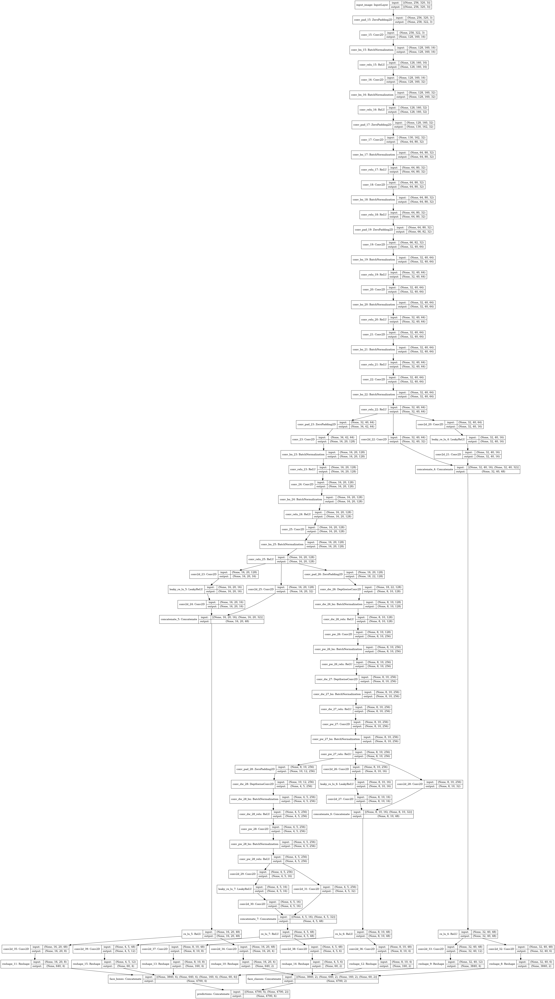

In [52]:
model = SsdModel()
model.summary()
tf.keras.utils.plot_model(
    model, 
    to_file=os.path.join(os.getcwd(), 'model.png'),
    show_shapes=True, 
    show_layer_names=True
)

In [53]:
filepath = os.path.join(PROJECT_PATH, 'checkpoints', 'weights_epoch_008.h5')
model.load_weights(filepath)

### weights_epoch_008.h5 에서 50 epoch 추가 학습진행

In [54]:
EPOCHS = 50 # 100
best_loss = float('inf')

In [ ]:
# 학습 루프
for epoch in range(EPOCHS):
    epoch_loss = 0.0
    for step, (inputs, labels) in enumerate(train_dataset.take(steps_per_epoch)):
        load_t0 = time.time()
        total_loss, losses = train_step(inputs, labels)
        load_t1 = time.time()
        batch_time = load_t1 - load_t0
        
        epoch_loss += total_loss.numpy()
        print(f"\rEpoch: {epoch + 1}/{EPOCHS} | Batch {step + 1}/{steps_per_epoch} | "
              f"Batch time {batch_time:.3f}s || Loss: {total_loss:.6f} | "
              f"loc loss: {losses['loc']:.6f} | class loss: {losses['class']:.6f} ", 
              end='', flush=True)
    
    # 에폭당 평균 손실 계산
    epoch_loss /= steps_per_epoch
    print(f"\nEpoch {epoch + 1} 완료 | Average Loss: {epoch_loss:.6f}")
    
    # 베스트 모델 저장
    if epoch_loss < best_loss:
        best_loss = epoch_loss
        model.save_weights(BEST_MODEL_PATH)
        print(f"Best model saved with loss: {best_loss:.6f} at epoch {epoch + 1}")

Epoch: 1/50 | Batch 402/402 | Batch time 0.085s || Loss: 5.034207 | loc loss: 3.739182 | class loss: 1.295025 
Epoch 1 완료 | Average Loss: 5.452103
Best model saved with loss: 5.452103 at epoch 1
Epoch: 2/50 | Batch 402/402 | Batch time 0.079s || Loss: 7.049064 | loc loss: 5.401096 | class loss: 1.647968  
Epoch 2 완료 | Average Loss: 5.533720
Epoch: 3/50 | Batch 402/402 | Batch time 0.079s || Loss: 6.105219 | loc loss: 4.653115 | class loss: 1.452104 1 
Epoch 3 완료 | Average Loss: 5.498472
Epoch: 4/50 | Batch 402/402 | Batch time 0.064s || Loss: 4.083400 | loc loss: 2.682571 | class loss: 1.400828 
Epoch 4 완료 | Average Loss: 5.599152
Epoch: 5/50 | Batch 402/402 | Batch time 0.085s || Loss: 4.413219 | loc loss: 2.929291 | class loss: 1.483929  
Epoch 5 완료 | Average Loss: 5.592775
Epoch: 6/50 | Batch 402/402 | Batch time 0.079s || Loss: 6.726980 | loc loss: 5.000050 | class loss: 1.726930 
Epoch 6 완료 | Average Loss: 5.497951
Epoch: 7/50 | Batch 402/402 | Batch time 0.076s || Loss: 5.187841 

In [ ]:
model.load_weights(BEST_MODEL_PATH)

In [168]:
# def load_custom_ssd_model(model_path):
#     """
#     SsdModel을 초기화하고 저장된 가중치를 로드합니다.
    
#     :param model_path: 저장된 가중치 파일 경로
#     :return: SSD 모델 객체
#     """
#     try:
#         # 모델 초기화
#         model = SsdModel()
#         print("SSD 모델이 성공적으로 초기화되었습니다.")
        
#         # 가중치 불러오기
#         if os.path.exists(model_path):
#             model.load_weights(model_path)
#             print(f"베스트 모델 가중치가 성공적으로 불러와졌습니다: {model_path}")
#         else:
#             raise FileNotFoundError(f"베스트 모델 가중치 파일이 존재하지 않습니다: {model_path}")
        
#         return model
    
#     except FileNotFoundError as e:
#         print(e)
#         return None
#     except Exception as e:
#         print(f"오류 발생: {e}")
#         return None

In [169]:
# my_best_model = load_custom_ssd_model(BEST_MODEL_PATH)

# # 모델 구조 확인
# if my_best_model is not None:
#     print("베스트 SSD 모델이 성공적으로 로드되었습니다.")
#     print("모델 레이어 수:", len(my_best_model.layers))
#     my_best_model.summary()
# else:
#     print("베스트 모델 로드에 실패했습니다.")

SSD 모델이 성공적으로 초기화되었습니다.
베스트 모델 가중치가 성공적으로 불러와졌습니다: /aiffel/aiffel/AIFFEL_quest_rs/GoingDeeper/GD05/best_mymodel_100.h5
베스트 SSD 모델이 성공적으로 로드되었습니다.
모델 레이어 수: 101
Model: "ssd_model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        [(None, 256, 320, 3) 0                                            
__________________________________________________________________________________________________
conv_pad_113 (ZeroPadding2D)    (None, 258, 322, 3)  0           input_image[0][0]                
__________________________________________________________________________________________________
conv_113 (Conv2D)               (None, 128, 160, 16) 432         conv_pad_113[0][0]               
__________________________________________________________________________________________________
conv_bn_113 (BatchNormalizati

#### 잘 훈련된 해당 모델을 통해 적절한 얼굴 bounding box를 찾아내 봅시다. inference.py 코드를 적극적으로 참고

In [ ]:
ss
import sys
# 경로 추가 (모듈이 있는 경로로 수정)
sys.path.append(PROJECT_PATH)

In [ ]:
from tf_build_ssd_model import SsdModel
import config

In [ ]:
# 기본 설정 확인
cfg = config.cfg

print("PROJECT_PATH:", PROJECT_PATH)
print("MODEL_PATH:", MODEL_PATH)
print("cfg keys:", cfg.keys())

In [ ]:
# SSD 모델 초기화 및 가중치 로드
def load_ssd_model(model_path, cfg):
    """
    SSD 모델을 초기화하고 가중치를 로드합니다.
    :param model_path: 가중치 파일 경로
    :param cfg: 모델 설정값
    :return: 초기화된 SSD 모델
    """
    try:
        # Default Box 설정
        min_sizes = cfg['min_sizes']
        num_cell = [len(min_sizes[k]) for k in range(len(cfg['steps']))]
        
        # 모델 초기화
        model = SsdModel(cfg=cfg, num_cell=num_cell, training=False)
        
        # 가중치 파일 확인
        if not os.path.exists(model_path):
            raise FileNotFoundError(f"가중치 파일을 찾을 수 없습니다: {model_path}")
        
        model.load_weights(model_path)
        print(f"SSD 모델이 성공적으로 로드되었습니다. 경로: {model_path}")
        
        return model
    
    except KeyError as e:
        print(f"KeyError: {e} - 설정(cfg)에 누락된 키가 있습니다.")
        return None
    except FileNotFoundError as e:
        print(e)
        return None
    except Exception as e:
        print(f"모델 로드 중 예외 발생: {e}")
        return None

In [ ]:
# 최신 가중치 파일 경로 지정
weights_path = os.path.join(MODEL_PATH, 'weights_epoch_008.h5')

# SSD 모델 불러오기
model = load_ssd_model(weights_path, cfg)

# 모델 확인
if model is not None:
    print("SSD 모델 준비 완료.")
else:
    print("SSD 모델 로드 실패. 경로 및 설정을 확인하세요.")

In [221]:
# 학습 루프
for epoch in range(EPOCHS):
    epoch_loss = 0.0
    for step, (inputs, labels) in enumerate(train_dataset.take(steps_per_epoch)):
        load_t0 = time.time()
        total_loss, losses = train_step(inputs, labels)
        load_t1 = time.time()
        batch_time = load_t1 - load_t0
        
        epoch_loss += total_loss.numpy()
        print(f"\rEpoch: {epoch + 1}/{EPOCHS} | Batch {step + 1}/{steps_per_epoch} | "
              f"Batch time {batch_time:.3f}s || Loss: {total_loss:.6f} | "
              f"loc loss: {losses['loc']:.6f} | class loss: {losses['class']:.6f} ", 
              end='', flush=True)
    
    # 에폭당 평균 손실 계산
    epoch_loss /= steps_per_epoch
    print(f"\nEpoch {epoch + 1} 완료 | Average Loss: {epoch_loss:.6f}")
    
    # 베스트 모델 저장
    if epoch_loss < best_loss:
        best_loss = epoch_loss
        model.save_weights(RETRAIN_MODEL_PATH)
        print(f"Best retrain saved with loss: {best_loss:.6f} at epoch {epoch + 1}")

Epoch: 1/50 | Batch 402/402 | Batch time 0.080s || Loss: 5.430823 | loc loss: 3.380937 | class loss: 2.049886   
Epoch 1 완료 | Average Loss: 11.040311
Best retrain saved with loss: 11.040311 at epoch 1
Epoch: 2/50 | Batch 402/402 | Batch time 0.054s || Loss: 6.704438 | loc loss: 4.825405 | class loss: 1.879033  
Epoch 2 완료 | Average Loss: 7.073596
Best retrain saved with loss: 7.073596 at epoch 2
Epoch: 3/50 | Batch 402/402 | Batch time 0.080s || Loss: 8.451870 | loc loss: 6.448208 | class loss: 2.003662  
Epoch 3 완료 | Average Loss: 6.746868
Best retrain saved with loss: 6.746868 at epoch 3
Epoch: 4/50 | Batch 402/402 | Batch time 0.081s || Loss: 7.809753 | loc loss: 5.891636 | class loss: 1.918118  
Epoch 4 완료 | Average Loss: 6.411380
Best retrain saved with loss: 6.411380 at epoch 4
Epoch: 5/50 | Batch 402/402 | Batch time 0.079s || Loss: 5.854770 | loc loss: 3.893991 | class loss: 1.960778  
Epoch 5 완료 | Average Loss: 6.420777
Epoch: 6/50 | Batch 402/402 | Batch time 0.084s || Loss: 

Epoch: 49/50 | Batch 402/402 | Batch time 0.079s || Loss: 4.613971 | loc loss: 2.973294 | class loss: 1.640677 
Epoch 49 완료 | Average Loss: 5.343039
Best retrain saved with loss: 5.343039 at epoch 49
Epoch: 50/50 | Batch 402/402 | Batch time 0.077s || Loss: 4.976572 | loc loss: 3.546114 | class loss: 1.430457 
Epoch 50 완료 | Average Loss: 5.325512
Best retrain saved with loss: 5.325512 at epoch 50


In [224]:
# SSD 모델 불러오기
retrain_best_model = load_ssd_model(RETRAIN_MODEL_PATH, cfg)

# 모델 확인
if model is not None:
    print("SSD 모델 준비 완료.")
else:
    print("SSD 모델 로드 실패. 경로 및 설정을 확인하세요.")

SSD 모델이 성공적으로 로드되었습니다. 경로: /aiffel/aiffel/AIFFEL_quest_rs/GoingDeeper/GD05/best_retrain_model.h5
SSD 모델 준비 완료.


### inference

#### MMS 구현하기

In [57]:
def compute_nms(boxes, scores, nms_threshold=0.4, limit=200):
    if boxes.shape[0] == 0:
        return tf.constant([], dtype=tf.int32)
    selected = [0]
    idx = tf.argsort(scores, direction='DESCENDING')
    idx = idx[:limit]
    boxes = tf.gather(boxes, idx)

    iou = _jaccard(boxes, boxes)

    while True:
        row = iou[selected[-1]]
        next_indices = row <= nms_threshold

        iou = tf.where(
            tf.expand_dims(tf.math.logical_not(next_indices), 0),
            tf.ones_like(iou, dtype=tf.float32),
            iou
        )

        if not tf.math.reduce_any(next_indices):
            break

        selected.append(tf.argsort(
            tf.dtypes.cast(next_indices, tf.int32), direction='DESCENDING')[0].numpy())

    return tf.gather(idx, selected)

In [58]:
def decode_bbox_tf(predicts, boxes, variances=[0.1, 0.2]):
    centers = boxes[:, :2] + predicts[:, :2] * variances[0] * boxes[:, 2:]
    sides = boxes[:, 2:] * tf.math.exp(predicts[:, 2:] * variances[1])
    return tf.concat([centers - sides / 2, centers + sides / 2], axis=1)

In [59]:
def parse_predict(predictions, boxes):
    label_classes = IMAGE_LABELS

    bbox_predictions, confidences = tf.split(predictions[0], [4, -1], axis=-1)
    boxes = decode_bbox_tf(bbox_predictions, boxes)

    scores = tf.math.softmax(confidences, axis=-1)

    out_boxes = []
    out_labels = []
    out_scores = []

    for c in range(1, len(label_classes)):
        cls_scores = scores[:, c]

        score_idx = cls_scores > 0.5

        cls_boxes = boxes[score_idx]
        cls_scores = cls_scores[score_idx]

        nms_idx = compute_nms(cls_boxes, cls_scores)

        cls_boxes = tf.gather(cls_boxes, nms_idx)
        cls_scores = tf.gather(cls_scores, nms_idx)

        cls_labels = [c] * cls_boxes.shape[0]

        out_boxes.append(cls_boxes)
        out_labels.extend(cls_labels)
        out_scores.append(cls_scores)

    out_boxes = tf.concat(out_boxes, axis=0)
    out_scores = tf.concat(out_scores, axis=0)

    boxes = tf.clip_by_value(out_boxes, 0.0, 1.0).numpy()
    classes = np.array(out_labels)
    scores = out_scores.numpy()

    return boxes, classes, scores

### 얼굴에 바운딩 박스 그리기 

In [60]:
def pad_input_image(img, max_steps):
    img_h, img_w, _ = img.shape

    img_pad_h = 0
    if img_h % max_steps > 0:
        img_pad_h = max_steps - img_h % max_steps

    img_pad_w = 0
    if img_w % max_steps > 0:
        img_pad_w = max_steps - img_w % max_steps

    padd_val = np.mean(img, axis=(0, 1)).astype(np.uint8)
    img = cv2.copyMakeBorder(img, 0, img_pad_h, 0, img_pad_w,
                             cv2.BORDER_CONSTANT, value=padd_val.tolist())
    pad_params = (img_h, img_w, img_pad_h, img_pad_w)

    return img, pad_params

In [61]:
def recover_pad(boxes, pad_params):
    img_h, img_w, img_pad_h, img_pad_w = pad_params
    box = np.reshape(boxes[0], [-1, 2, 2]) * [(img_pad_w + img_w) / img_w, (img_pad_h + img_h) / img_h]
    boxes[0] = np.reshape(box, [-1, 4])
    return boxes

In [62]:
def draw_box_on_face(img, boxes, classes, scores, box_index, class_list):
    img_height = img.shape[0]
    img_width = img.shape[1]

    x_min = int(boxes[box_index][0] * img_width)
    y_min = int(boxes[box_index][1] * img_height)
    x_max = int(boxes[box_index][2] * img_width)
    y_max = int(boxes[box_index][3] * img_height)

    if classes[box_index] == 1:
        color = (0, 255, 0)
    else:
        color = (0, 0, 255)
    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color, 2)
    
    if len(scores) > box_index :
        score = "{:.4f}".format(scores[box_index])
        class_name = class_list[classes[box_index]]
        label = '{} {}'.format(class_name, score)
        position = (x_min, y_min - 4) 
        cv2.putText(img, label, position, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255))

In [162]:
def predict_and_visualize(image_path, model, image_height, image_width, box_steps, image_labels):
    """
    SSD 모델을 사용해 객체를 감지하고 결과를 시각화하는 함수.
    
    :param image_path: 입력 이미지 경로
    :param model: SSD 객체 감지 모델
    :param image_height: 모델 입력 이미지 높이
    :param image_width: 모델 입력 이미지 너비
    :param box_steps: SSD 모델의 BOX_STEPS 값
    :param image_labels: 클래스 레이블 목록
    """
    # 1. 이미지 전처리
    img_raw = cv2.imread(image_path)
    if img_raw is None:
        raise FileNotFoundError(f"이미지 파일을 찾을 수 없습니다: {image_path}")
    
    img_raw = cv2.resize(img_raw, (image_width, image_height))
    img = np.float32(img_raw.copy())
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # 이미지 패딩
    img, pad_params = pad_input_image(img, max_steps=max(box_steps))
    img = img / 255.0  # 정규화
    
    print(f" - 이미지 크기: {img.shape}")
    print(f" - 패딩 파라미터: {pad_params}")
    
    # 2. Default Box 생성
    boxes = default_box()
    boxes = tf.cast(boxes, tf.float32)
    
    # 3. 모델 예측
    predictions = model.predict(img[np.newaxis, ...])
    pred_boxes, labels, scores = parse_predict(predictions, boxes)
    pred_boxes = recover_pad(pred_boxes, pad_params)
    
    # 4. 결과 시각화
    for box_index in range(len(pred_boxes)):
        draw_box_on_face(img_raw, pred_boxes, labels, scores, box_index, image_labels)
    
    # 결과 표시
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
    plt.show()

In [226]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image_people.png')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


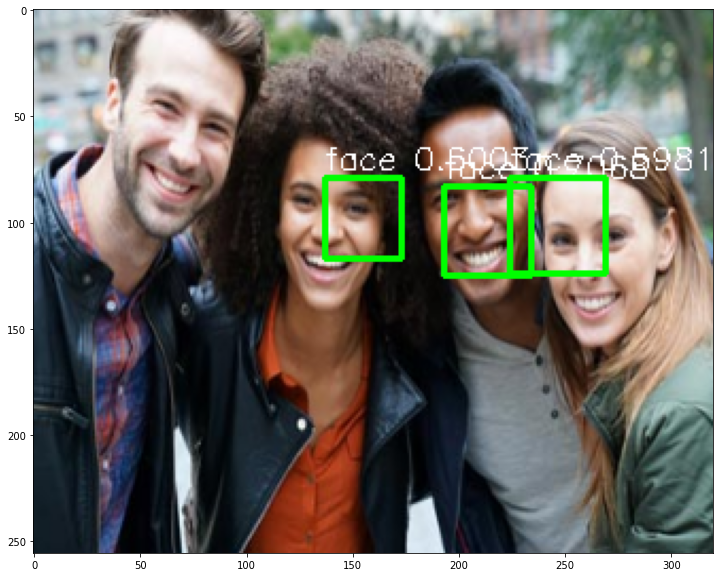

In [227]:
# pretrained SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


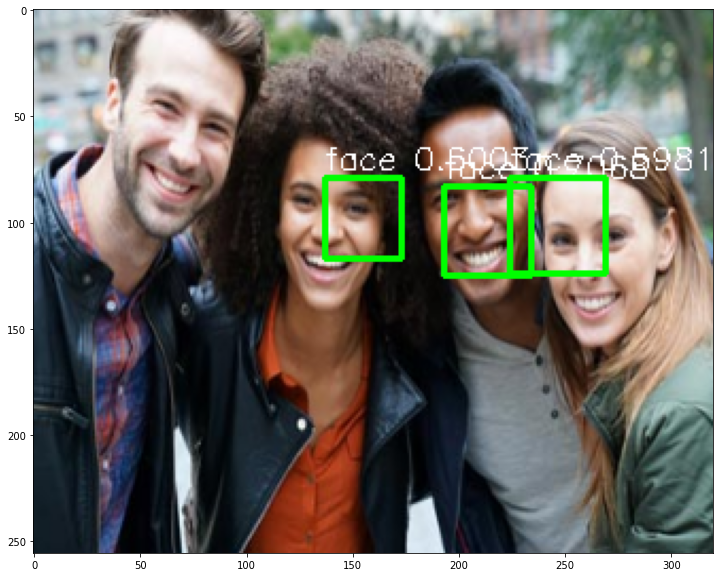

In [228]:
# pretrained SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=retrain_best_model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


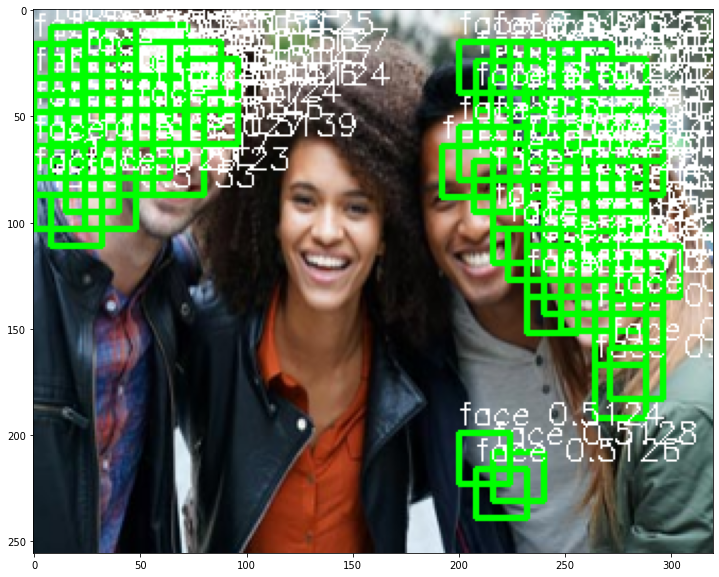

In [170]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=my_best_model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [171]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_2.jpg')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


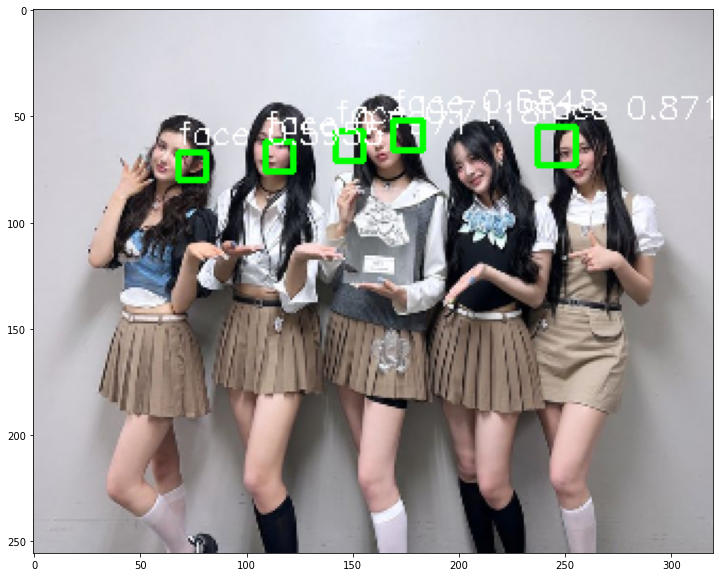

In [172]:
# pretrained SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


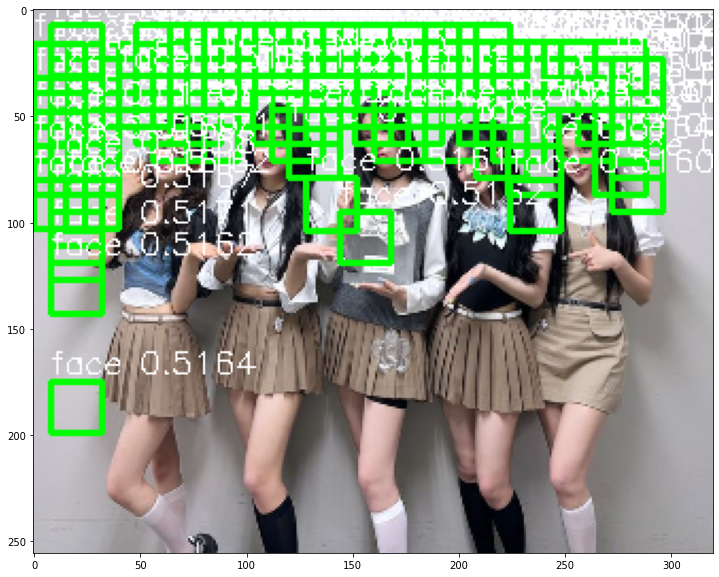

In [173]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=my_best_model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [174]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_3.jpg')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


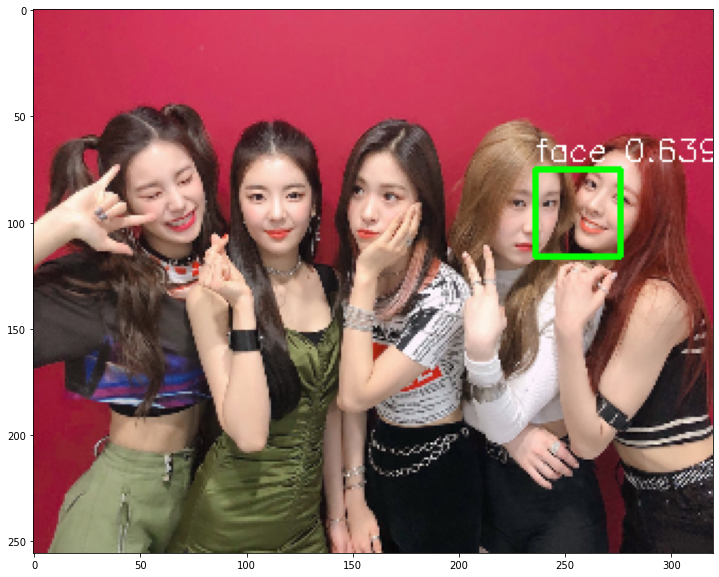

In [175]:
# pretrained SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


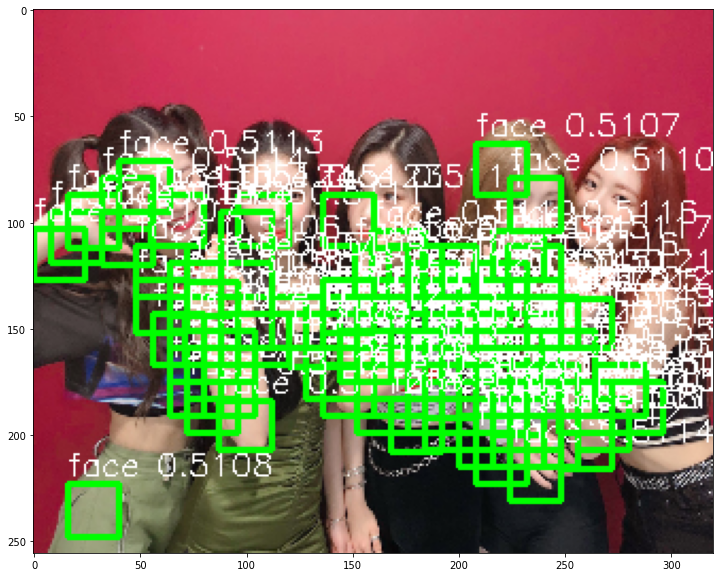

In [176]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=my_best_model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [177]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image8.png')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


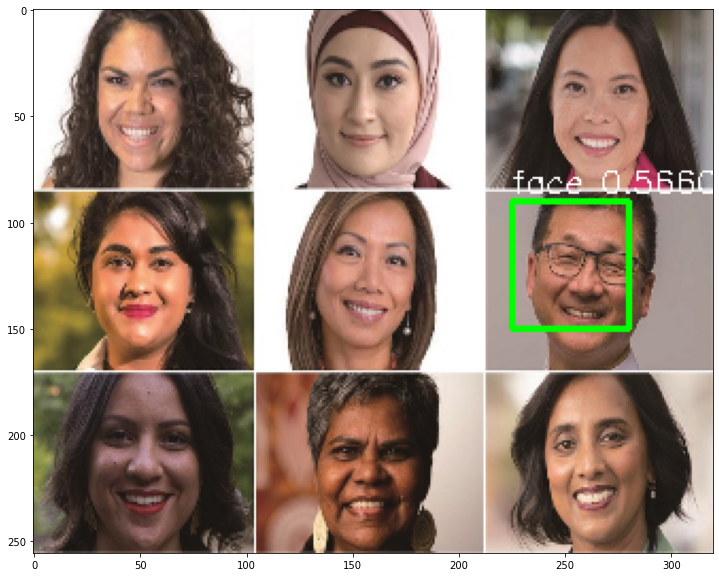

In [178]:
# pretrained SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


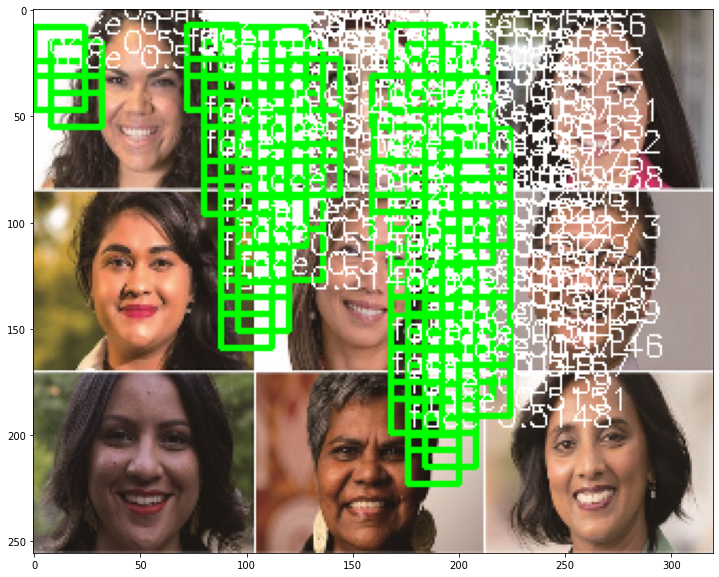

In [179]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=my_best_model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [180]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'lee.png')

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


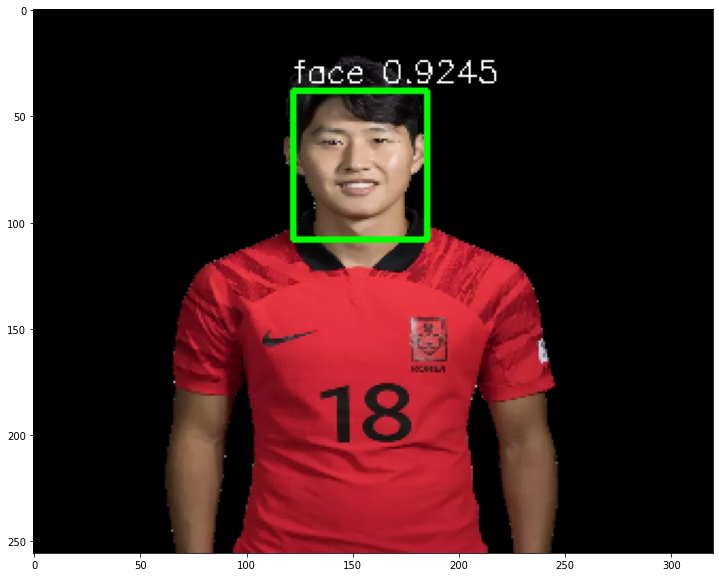

In [181]:
# pretrained SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

 - 이미지 크기: (256, 320, 3)
 - 패딩 파라미터: (256, 320, 0, 0)


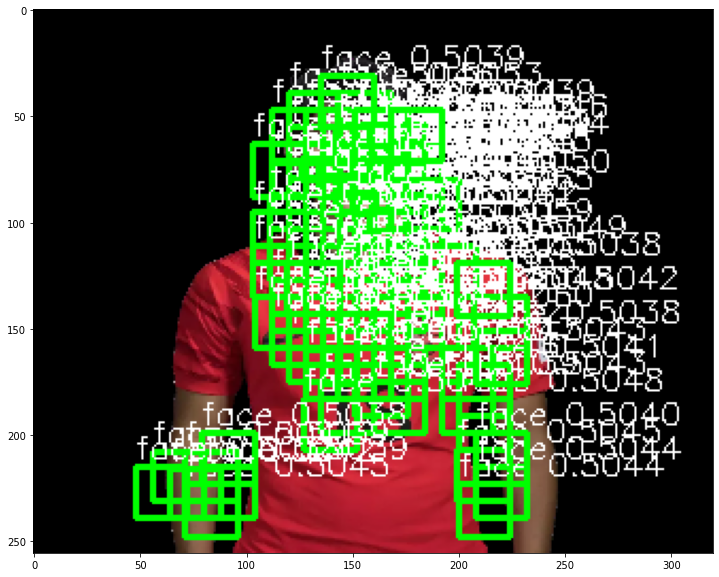

In [182]:
# myModel SSD 예측 및 시각화 실행
predict_and_visualize(
    image_path=TEST_IMAGE_PATH,
    model=my_best_model,
    image_height=IMAGE_HEIGHT,
    image_width=IMAGE_WIDTH,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

### Step 4. 스티커 합성 사진 생성하기
---
여러분들이 선택한 인물사진에 스티커를 합성해 봅시다. 이미지에 너무 많은 사람 얼굴이 포함되어 있거나, 검출된 얼굴이 너무 작아서 스티커 합성이 어울리지 않으면 적당하지 않겠죠? 3~5명 정도의 얼굴이 포함된 적당한 사진을 선택해 주세요.

생성된 이미지를 프로젝트 코드와 함께 제출해 주세요~

그동안 수고 많으셨습니다!!!

### 얼굴에 왕관 스티커 합성하기

In [183]:
def put_stickers(img, boxes, prior_index, img_sticker):
    """
    얼굴 Bounding Box 위에 왕관 스티커를 정확한 위치와 크기로 표시합니다.

    :param img: 원본 이미지
    :param boxes: 예측된 Bounding Box 리스트
    :param prior_index: 현재 박스 인덱스
    :param img_sticker: 스티커 이미지 (RGBA 지원)
    :return: 스티커가 적용된 이미지
    """
    img_height, img_width = img.shape[:2]

    # Bounding Box 좌표 계산
    x_min = int(boxes[prior_index][0] * img_width)
    y_min = int(boxes[prior_index][1] * img_height)
    x_max = int(boxes[prior_index][2] * img_width)
    y_max = int(boxes[prior_index][3] * img_height)

    face_width = x_max - x_min
    face_height = y_max - y_min

    # 스티커 크기 조정
    sticker_width = int(face_width * 1.2)
    sticker_height = int(sticker_width * 0.5)
    img_sticker = cv2.resize(img_sticker, (sticker_width, sticker_height))

    # 왕관 위치 조정
    crown_x_min = x_min - (sticker_width - face_width) // 2
    crown_y_min = y_min - sticker_height + int(face_height * 0.15)
    crown_x_max = crown_x_min + sticker_width
    crown_y_max = crown_y_min + sticker_height

    # 이미지 경계 확인
    if (crown_y_min < 0 or crown_x_min < 0 or
        crown_x_max > img_width or crown_y_max > img_height):
        print("왕관 스티커가 이미지 범위를 벗어났습니다.")
        return img

    # 알파 채널을 사용해 스티커 합성
    sticker_area = img[crown_y_min:crown_y_max, crown_x_min:crown_x_max]
    
    if img_sticker.shape[-1] == 4:
        alpha_mask = img_sticker[:, :, 3] / 255.0  # 알파 채널 (0~1 범위)
        alpha_inv = 1.0 - alpha_mask
        
        # RGB 채널만 사용
        for c in range(0, 3):
            sticker_area[:, :, c] = (alpha_mask * img_sticker[:, :, c] +
                                     alpha_inv * sticker_area[:, :, c])
    else:
        # 알파 채널이 없을 경우 직접 합성
        sticker_area = np.where(
            img_sticker == 0,
            sticker_area,
            img_sticker
        ).astype(np.uint8)

    img[crown_y_min:crown_y_max, crown_x_min:crown_x_max] = sticker_area
    return img

In [184]:
def process_image_with_sticker(image_path, img_sticker, model, image_width, image_height, box_steps, image_labels):
    """
    이미지에서 얼굴을 검출하고 왕관 스티커를 적용한 후 시각화합니다.
    
    :param image_path: 입력 이미지 경로
    :param img_sticker: 왕관 스티커 이미지
    :param model: SSD 객체 탐지 모델
    :param image_width: 모델 입력 이미지 너비
    :param image_height: 모델 입력 이미지 높이
    :param box_steps: SSD 모델의 BOX_STEPS 값
    :param image_labels: 클래스 레이블 목록
    """
    # 이미지 불러오기 및 확인
    img_raw = cv2.imread(image_path)
    if img_raw is None:
        raise FileNotFoundError(f"이미지 파일을 찾을 수 없습니다: {image_path}")
    
    # 이미지 전처리**
    img_raw = cv2.resize(img_raw, (image_width, image_height))
    img = np.float32(img_raw.copy())
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # 이미지 패딩
    img, pad_params = pad_input_image(img, max_steps=max(box_steps))
    img = img / 255.0  # 정규화
    
    # Default Box 생성 및 모델 예측
    boxes = default_box()
    boxes = tf.cast(boxes, tf.float32)
    
    predictions = model.predict(img[np.newaxis, ...])
    pred_boxes, labels, scores = parse_predict(predictions, boxes)
    pred_boxes = recover_pad(pred_boxes, pad_params)
    
    # 왕관 스티커 적용
    for box_index in range(len(pred_boxes)):
        img_raw = put_stickers(img_raw, pred_boxes, box_index, img_sticker)
    
    # 결과 시각화
    plt.figure(figsize=(14, 10))
    plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
    plt.show()

In [185]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image_people.png')

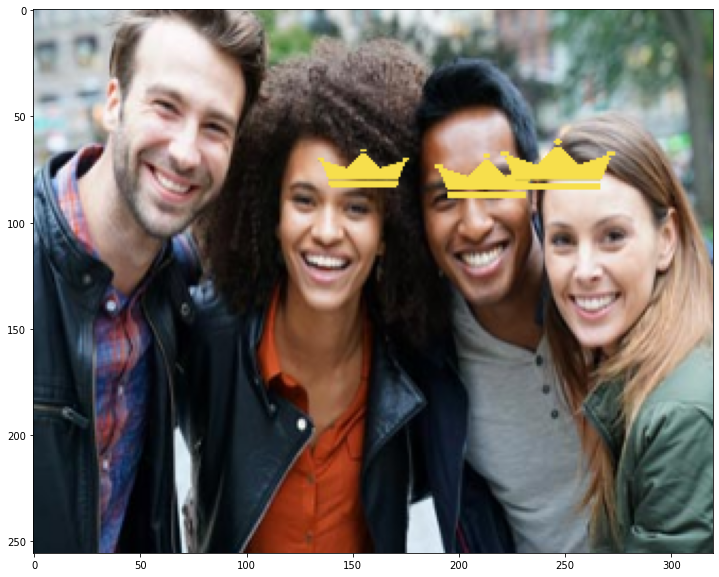

In [186]:
# 모델 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.


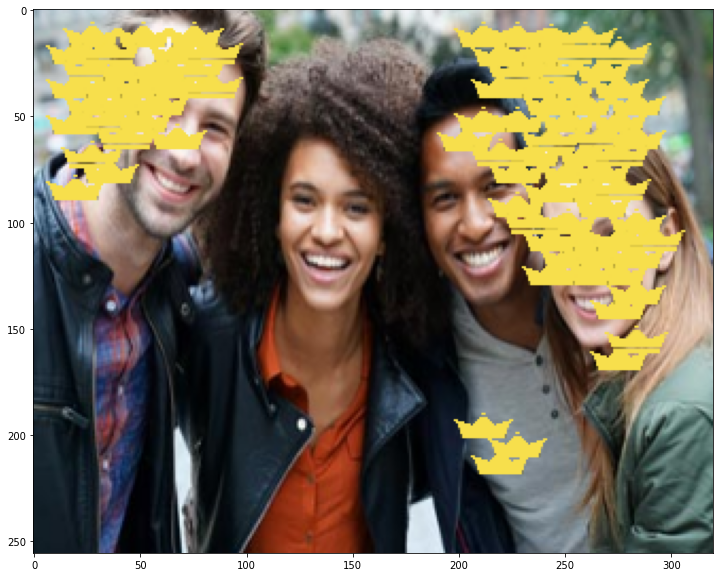

In [187]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=my_best_model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [188]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_2.jpg')

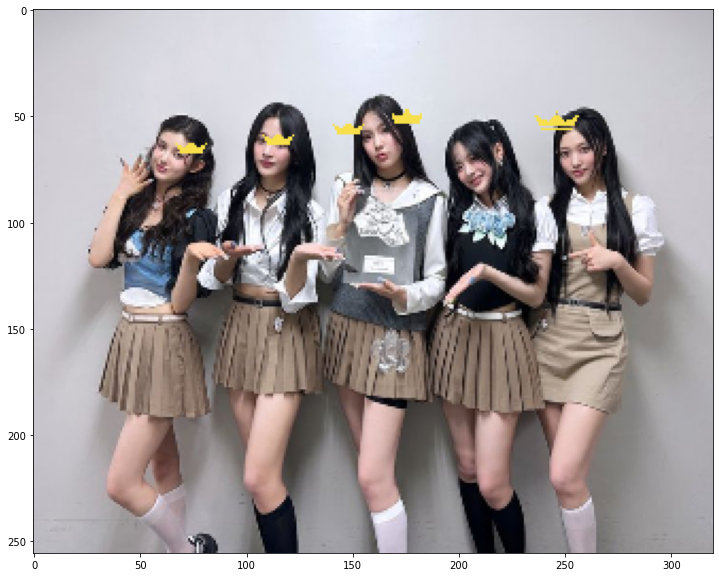

In [189]:
# 모델 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.


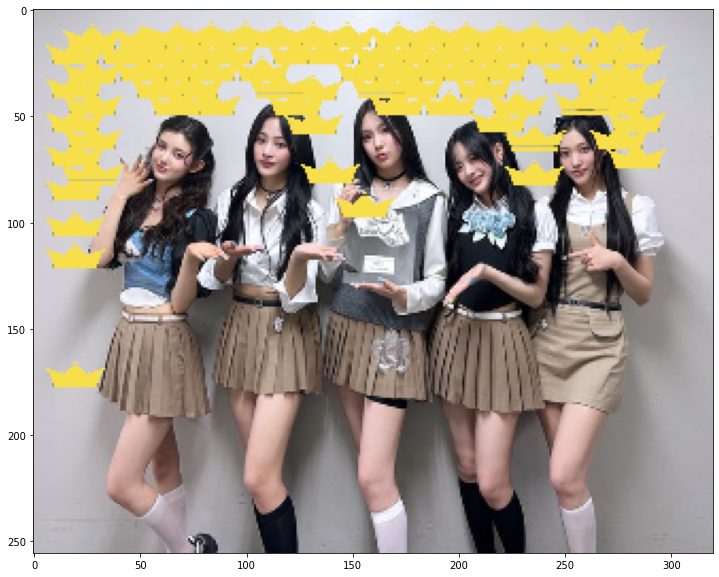

In [190]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=my_best_model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [191]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_3.jpg')

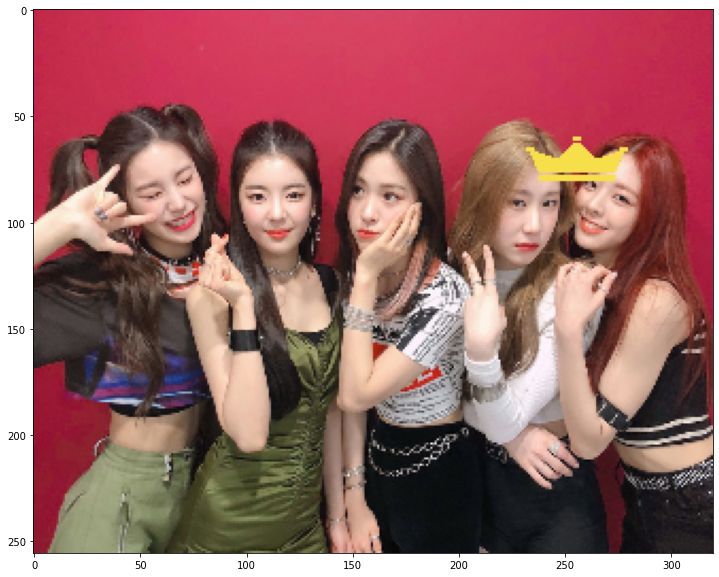

In [192]:
# 모델 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

왕관 스티커가 이미지 범위를 벗어났습니다.


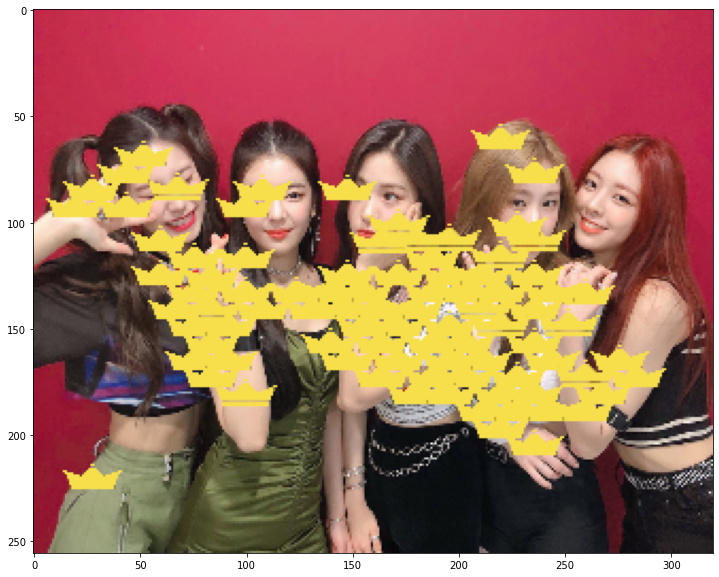

In [193]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=my_best_model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [194]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image8.png')

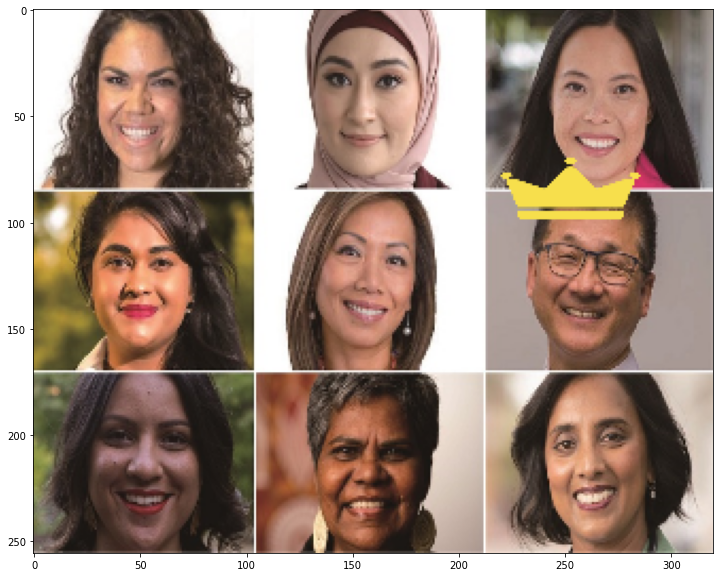

In [195]:
# 모델 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.
왕관 스티커가 이미지 범위를 벗어났습니다.


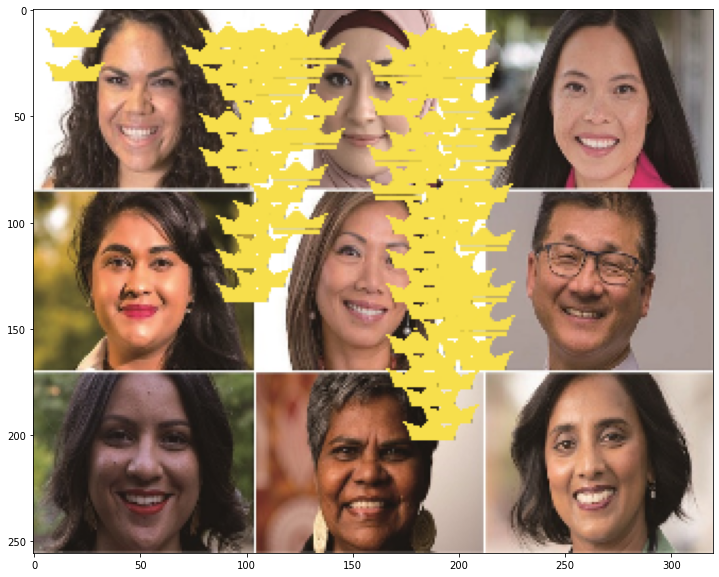

In [196]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=my_best_model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

In [197]:
# 이미지 경로
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'lee.png')

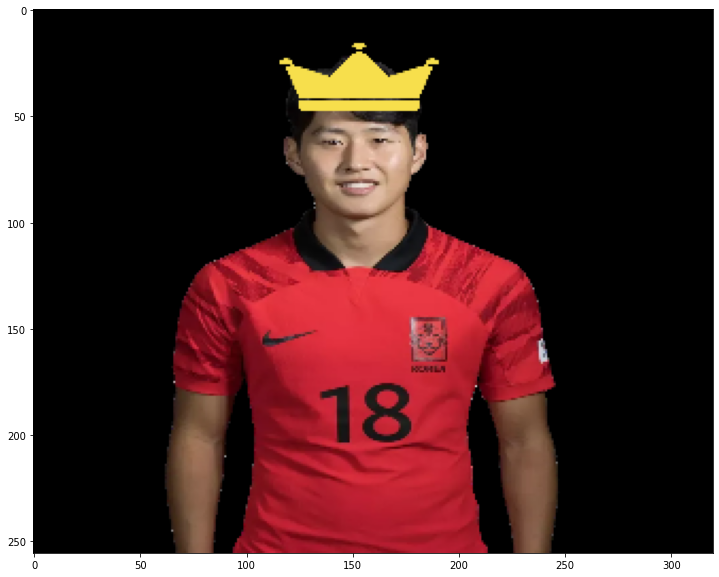

In [198]:
# 모델 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

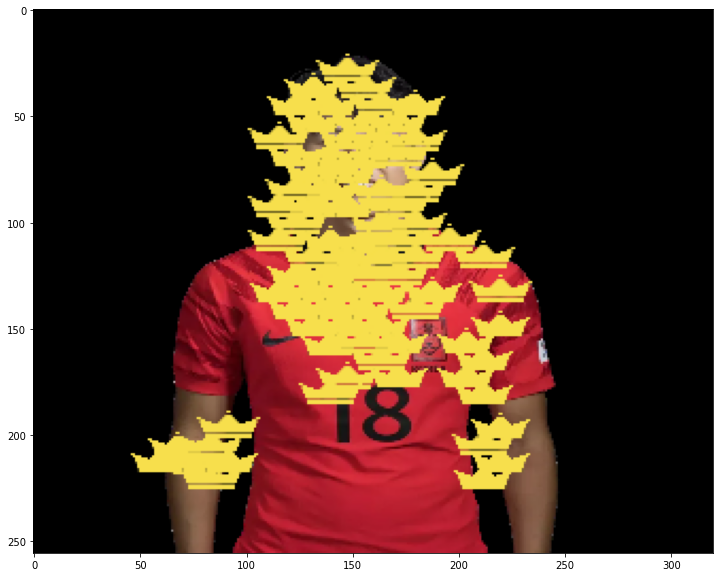

In [199]:
# myModel 예측 및 스티커 적용
process_image_with_sticker(
    image_path=TEST_IMAGE_PATH,
    img_sticker=img_sticker,
    model=my_best_model,
    image_width=IMAGE_WIDTH,
    image_height=IMAGE_HEIGHT,
    box_steps=BOX_STEPS,
    image_labels=IMAGE_LABELS
)

### Step 3. dlib 을 이용한 landmark 찾기 (선택사항)
---
붙이려는 이미지에 따라 face landmark를 찾아야 할 수도 있습니다. 검출된 bounding box에 dlib을 적용해 face landmark를 찾을 수 있을 것입니다.
dlib를 이용하려는 경우, inference.py 에서 show_image 메소드를 사용한 부분을 적절히 수정해야 가능할 것입니다.

In [200]:
import dlib

In [201]:
landmark_model_path = os.getenv('HOME')+'/aiffel/camera_sticker/models/shape_predictor_68_face_landmarks.dat'
    # 저장한 landmark 모델의 주소를 model_path 변수에 저장
landmark_predictor = dlib.shape_predictor(landmark_model_path)
    # dlib 라이브러리의 shape_predictor 함수를 이용하여 모델을 불러옴
    # landmark_predictor는 RGB이미지와 dlib.rectangle를 입력 받고 dlib.full_object_detection를 반환
    # dlib.rectangle: 내부를 예측하는 박스
    # dlib.full_object_detection: 각 구성 요소의 위치와, 이미지 상의 객체의 위치를 나타냄

검출된 얼굴 수: 1
첫 번째 얼굴의 랜드마크 수: 68


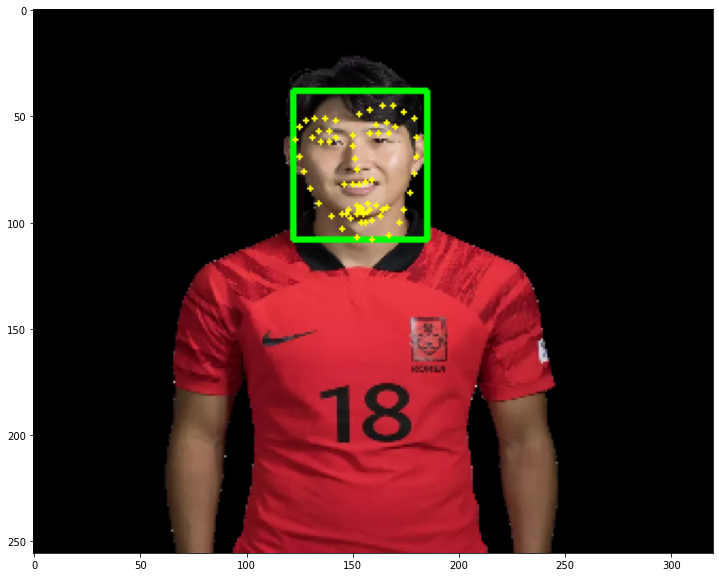

In [202]:
# 이미지 불러오기 및 전처리
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'lee.png')

img_raw = cv2.imread(TEST_IMAGE_PATH)
img_raw = cv2.resize(img_raw, (IMAGE_WIDTH, IMAGE_HEIGHT))
img = np.float32(img_raw.copy())
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img, pad_params = pad_input_image(img, max_steps=max(BOX_STEPS))
img = img / 255.0

# Default Box 및 예측 수행
boxes = default_box()
boxes = tf.cast(boxes, tf.float32)

predictions = model.predict(img[np.newaxis, ...])
pred_boxes, labels, scores = parse_predict(predictions, boxes)
pred_boxes = recover_pad(pred_boxes, pad_params)

# Bounding Box & Landmark 검출
list_landmarks = []

for box in pred_boxes:
    # Bounding Box 좌표 변환
    x_min = int(box[0] * IMAGE_WIDTH)
    y_min = int(box[1] * IMAGE_HEIGHT)
    x_max = int(box[2] * IMAGE_WIDTH)
    y_max = int(box[3] * IMAGE_HEIGHT)
    
    # 바운딩 박스 그리기
    cv2.rectangle(img_raw, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    
    # dlib.rectangle 변환
    dlib_rect = dlib.rectangle(x_min, y_min, x_max, y_max)
    
    # 랜드마크 예측
    points = landmark_predictor(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB), dlib_rect)
    
    # (x, y) 형태로 변환하여 저장
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)
    
    # 랜드마크 포인트 그리기
    for (x, y) in list_points:
        cv2.circle(img_raw, (x, y), 1, (0, 255, 255), -1)  # 노란색 포인트

# 결과 확인
print(f"검출된 얼굴 수: {len(list_landmarks)}")
if len(list_landmarks) > 0:
    print(f"첫 번째 얼굴의 랜드마크 수: {len(list_landmarks[0])}")

# 결과 시각화
plt.figure(figsize=(14, 10))
plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
plt.show()

검출된 얼굴 수: 3
첫 번째 얼굴의 랜드마크 수: 68


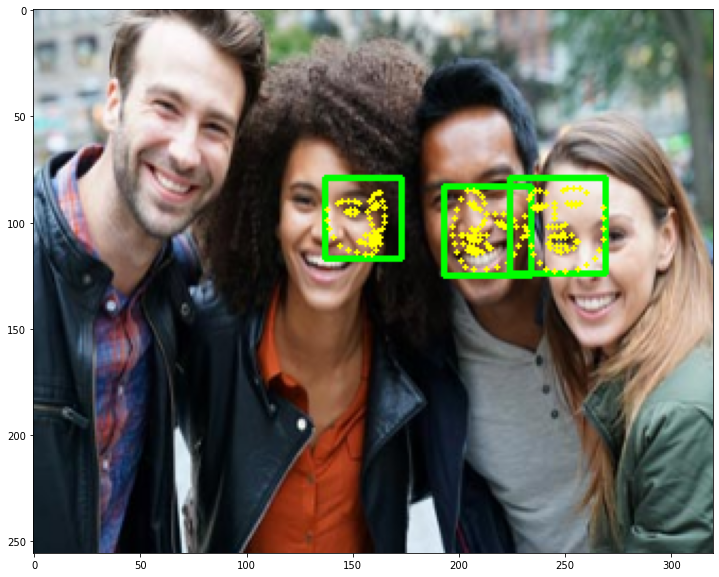

In [203]:
# 이미지 불러오기 및 전처리
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image_people.png')

img_raw = cv2.imread(TEST_IMAGE_PATH)
img_raw = cv2.resize(img_raw, (IMAGE_WIDTH, IMAGE_HEIGHT))
img = np.float32(img_raw.copy())
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img, pad_params = pad_input_image(img, max_steps=max(BOX_STEPS))
img = img / 255.0

# Default Box 및 예측 수행
boxes = default_box()
boxes = tf.cast(boxes, tf.float32)

predictions = model.predict(img[np.newaxis, ...])
pred_boxes, labels, scores = parse_predict(predictions, boxes)
pred_boxes = recover_pad(pred_boxes, pad_params)

# Bounding Box & Landmark 검출
list_landmarks = []

for box in pred_boxes:
    # Bounding Box 좌표 변환
    x_min = int(box[0] * IMAGE_WIDTH)
    y_min = int(box[1] * IMAGE_HEIGHT)
    x_max = int(box[2] * IMAGE_WIDTH)
    y_max = int(box[3] * IMAGE_HEIGHT)
    
    # 바운딩 박스 그리기
    cv2.rectangle(img_raw, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    
    # dlib.rectangle 변환
    dlib_rect = dlib.rectangle(x_min, y_min, x_max, y_max)
    
    # 랜드마크 예측
    points = landmark_predictor(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB), dlib_rect)
    
    # (x, y) 형태로 변환하여 저장
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)
    
    # 랜드마크 포인트 그리기
    for (x, y) in list_points:
        cv2.circle(img_raw, (x, y), 1, (0, 255, 255), -1)  # 노란색 포인트

# 결과 확인
print(f"검출된 얼굴 수: {len(list_landmarks)}")
if len(list_landmarks) > 0:
    print(f"첫 번째 얼굴의 랜드마크 수: {len(list_landmarks[0])}")

# 결과 시각화
plt.figure(figsize=(14, 10))
plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
plt.show()

검출된 얼굴 수: 5
첫 번째 얼굴의 랜드마크 수: 68


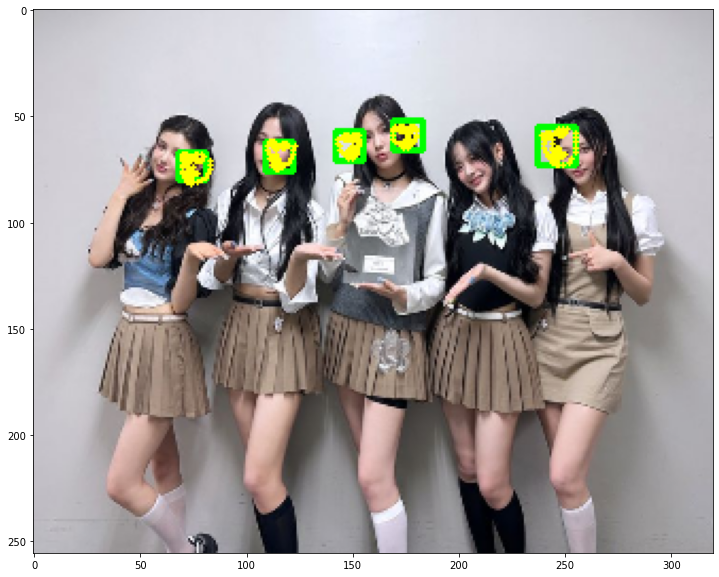

In [204]:
# 이미지 불러오기 및 전처리
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_2.jpg')

img_raw = cv2.imread(TEST_IMAGE_PATH)
img_raw = cv2.resize(img_raw, (IMAGE_WIDTH, IMAGE_HEIGHT))
img = np.float32(img_raw.copy())
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img, pad_params = pad_input_image(img, max_steps=max(BOX_STEPS))
img = img / 255.0

# Default Box 및 예측 수행
boxes = default_box()
boxes = tf.cast(boxes, tf.float32)

predictions = model.predict(img[np.newaxis, ...])
pred_boxes, labels, scores = parse_predict(predictions, boxes)
pred_boxes = recover_pad(pred_boxes, pad_params)

# Bounding Box & Landmark 검출
list_landmarks = []

for box in pred_boxes:
    # Bounding Box 좌표 변환
    x_min = int(box[0] * IMAGE_WIDTH)
    y_min = int(box[1] * IMAGE_HEIGHT)
    x_max = int(box[2] * IMAGE_WIDTH)
    y_max = int(box[3] * IMAGE_HEIGHT)
    
    # 바운딩 박스 그리기
    cv2.rectangle(img_raw, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    
    # dlib.rectangle 변환
    dlib_rect = dlib.rectangle(x_min, y_min, x_max, y_max)
    
    # 랜드마크 예측
    points = landmark_predictor(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB), dlib_rect)
    
    # (x, y) 형태로 변환하여 저장
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)
    
    # 랜드마크 포인트 그리기
    for (x, y) in list_points:
        cv2.circle(img_raw, (x, y), 1, (0, 255, 255), -1)  # 노란색 포인트

# 결과 확인
print(f"검출된 얼굴 수: {len(list_landmarks)}")
if len(list_landmarks) > 0:
    print(f"첫 번째 얼굴의 랜드마크 수: {len(list_landmarks[0])}")

# 결과 시각화
plt.figure(figsize=(14, 10))
plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
plt.show()

검출된 얼굴 수: 1
첫 번째 얼굴의 랜드마크 수: 68


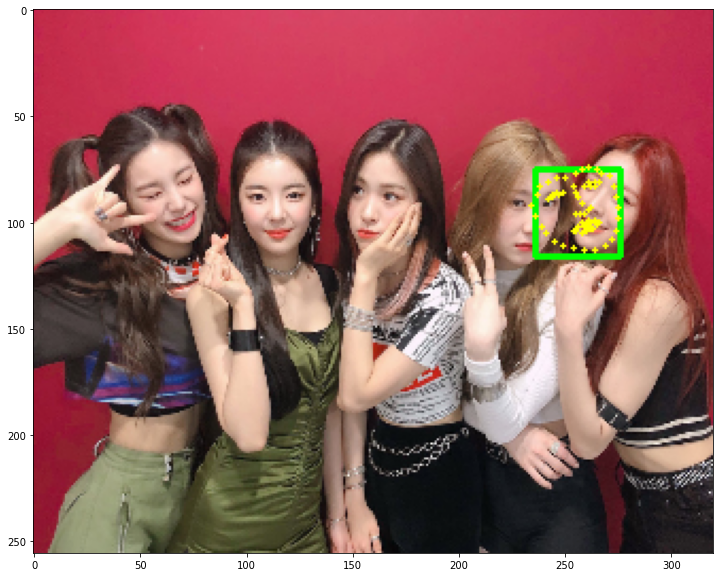

In [205]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'people_3.jpg')

img_raw = cv2.imread(TEST_IMAGE_PATH)
img_raw = cv2.resize(img_raw, (IMAGE_WIDTH, IMAGE_HEIGHT))
img = np.float32(img_raw.copy())
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img, pad_params = pad_input_image(img, max_steps=max(BOX_STEPS))
img = img / 255.0

# Default Box 및 예측 수행
boxes = default_box()
boxes = tf.cast(boxes, tf.float32)

predictions = model.predict(img[np.newaxis, ...])
pred_boxes, labels, scores = parse_predict(predictions, boxes)
pred_boxes = recover_pad(pred_boxes, pad_params)

# Bounding Box & Landmark 검출
list_landmarks = []

for box in pred_boxes:
    # Bounding Box 좌표 변환
    x_min = int(box[0] * IMAGE_WIDTH)
    y_min = int(box[1] * IMAGE_HEIGHT)
    x_max = int(box[2] * IMAGE_WIDTH)
    y_max = int(box[3] * IMAGE_HEIGHT)
    
    # 바운딩 박스 그리기
    cv2.rectangle(img_raw, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    
    # dlib.rectangle 변환
    dlib_rect = dlib.rectangle(x_min, y_min, x_max, y_max)
    
    # 랜드마크 예측
    points = landmark_predictor(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB), dlib_rect)
    
    # (x, y) 형태로 변환하여 저장
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)
    
    # 랜드마크 포인트 그리기
    for (x, y) in list_points:
        cv2.circle(img_raw, (x, y), 1, (0, 255, 255), -1)  # 노란색 포인트

# 결과 확인
print(f"검출된 얼굴 수: {len(list_landmarks)}")
if len(list_landmarks) > 0:
    print(f"첫 번째 얼굴의 랜드마크 수: {len(list_landmarks[0])}")

# 결과 시각화
plt.figure(figsize=(14, 10))
plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
plt.show()

검출된 얼굴 수: 1
첫 번째 얼굴의 랜드마크 수: 68


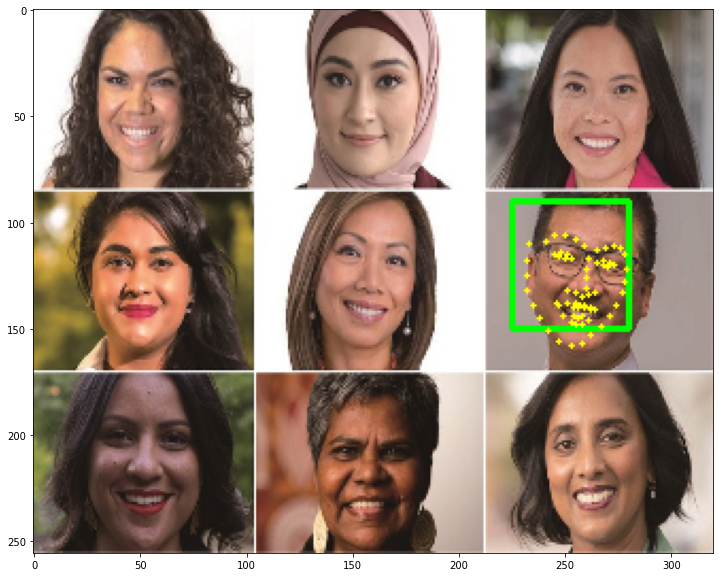

In [206]:
TEST_IMAGE_PATH = os.path.join(PROJECT_PATH, 'image8.png')

img_raw = cv2.imread(TEST_IMAGE_PATH)
img_raw = cv2.resize(img_raw, (IMAGE_WIDTH, IMAGE_HEIGHT))
img = np.float32(img_raw.copy())
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img, pad_params = pad_input_image(img, max_steps=max(BOX_STEPS))
img = img / 255.0

# Default Box 및 예측 수행
boxes = default_box()
boxes = tf.cast(boxes, tf.float32)

predictions = model.predict(img[np.newaxis, ...])
pred_boxes, labels, scores = parse_predict(predictions, boxes)
pred_boxes = recover_pad(pred_boxes, pad_params)

# Bounding Box & Landmark 검출
list_landmarks = []

for box in pred_boxes:
    # Bounding Box 좌표 변환
    x_min = int(box[0] * IMAGE_WIDTH)
    y_min = int(box[1] * IMAGE_HEIGHT)
    x_max = int(box[2] * IMAGE_WIDTH)
    y_max = int(box[3] * IMAGE_HEIGHT)
    
    # 바운딩 박스 그리기
    cv2.rectangle(img_raw, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    
    # dlib.rectangle 변환
    dlib_rect = dlib.rectangle(x_min, y_min, x_max, y_max)
    
    # 랜드마크 예측
    points = landmark_predictor(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB), dlib_rect)
    
    # (x, y) 형태로 변환하여 저장
    list_points = list(map(lambda p: (p.x, p.y), points.parts()))
    list_landmarks.append(list_points)
    
    # 랜드마크 포인트 그리기
    for (x, y) in list_points:
        cv2.circle(img_raw, (x, y), 1, (0, 255, 255), -1)  # 노란색 포인트

# 결과 확인
print(f"검출된 얼굴 수: {len(list_landmarks)}")
if len(list_landmarks) > 0:
    print(f"첫 번째 얼굴의 랜드마크 수: {len(list_landmarks[0])}")

# 결과 시각화
plt.figure(figsize=(14, 10))
plt.imshow(cv2.cvtColor(img_raw, cv2.COLOR_BGR2RGB))
plt.show()

### 회고
- 사전 학습 된 weights_epoch_008.h5 을 가져온 모델에서 결과 이미지의 성능이 좋지 않게 나오고 있다.
    - dlib 의 detector_hog 보다 성능이 안나왔다.
    - 50 epoch 을 추가로 더 학습하여 결과를 비교 한다. 
- epoch 100 으로 학습한 모델 적용시 얼굴이 아닌 부분에 너무 많은 바운딩 박스가 나온다.

### 1. 사전 학습된 weights_epoch_008.h5 가중치 적용한 이미지 결과들
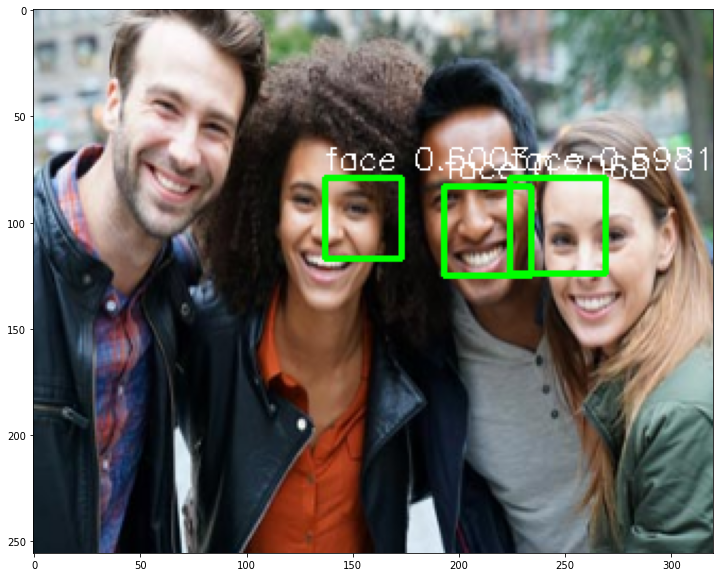
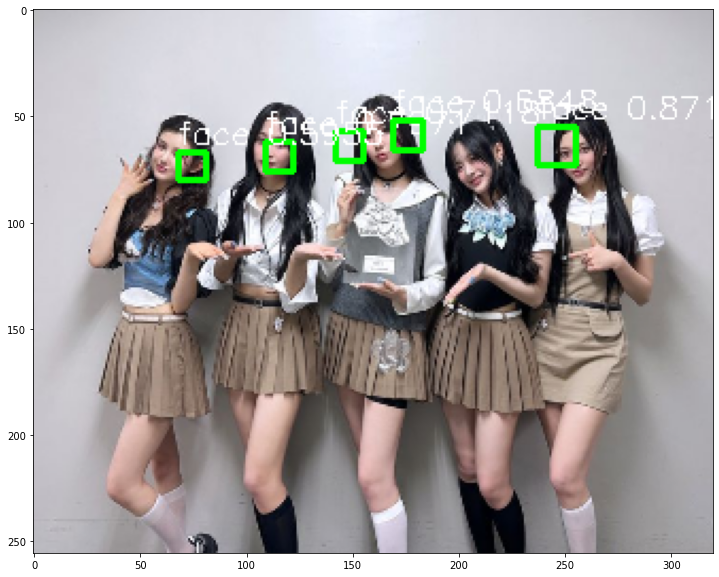
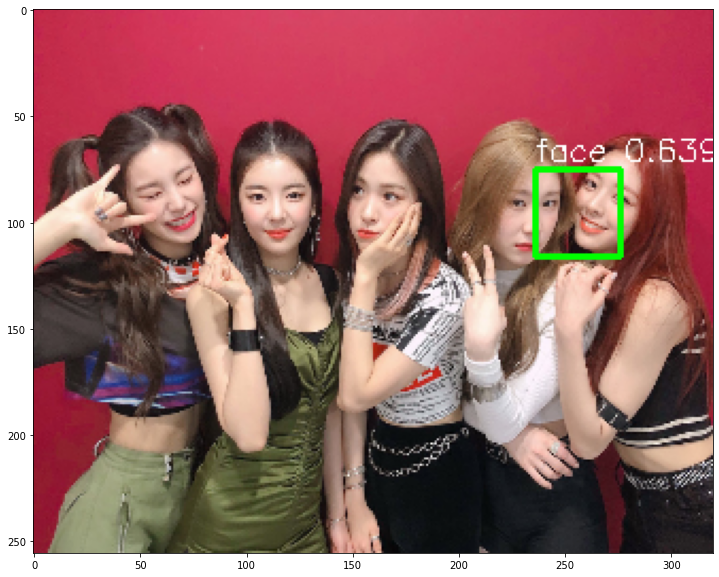
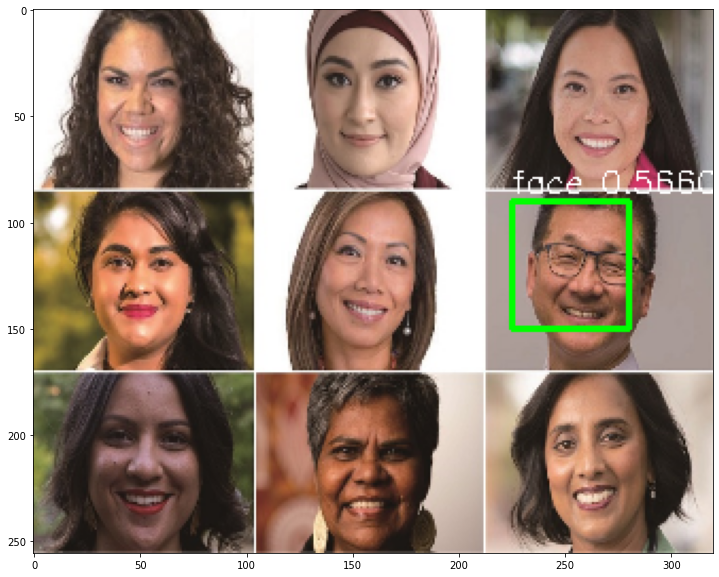
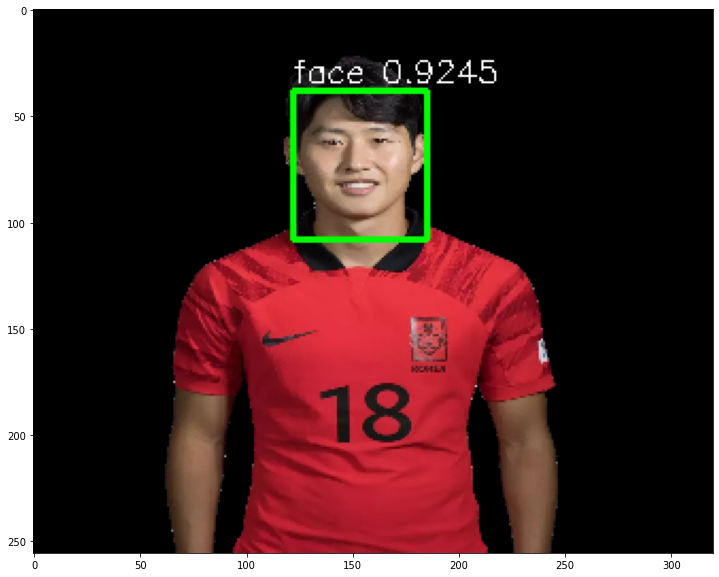
...
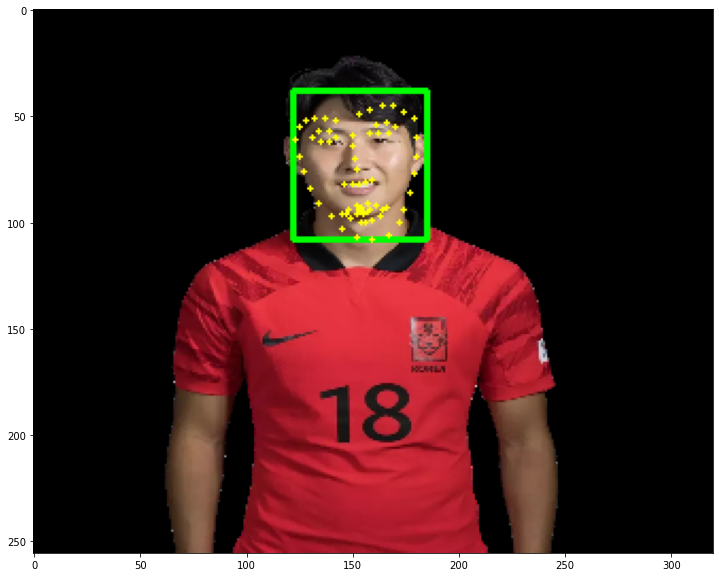
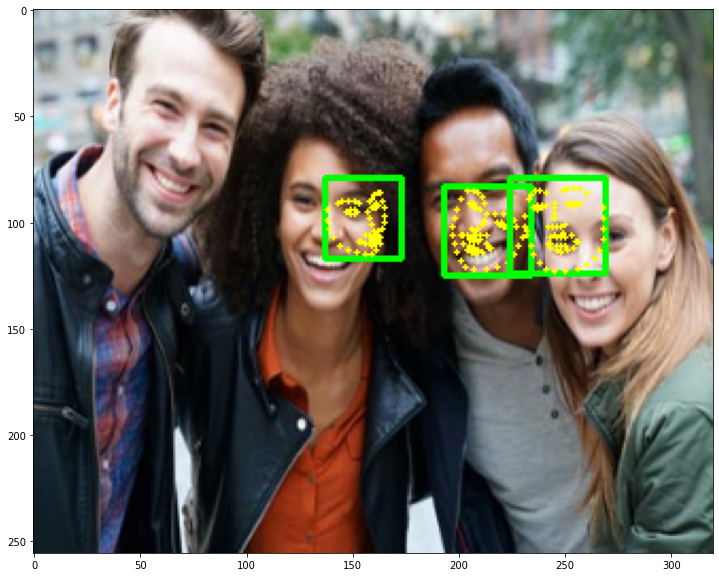
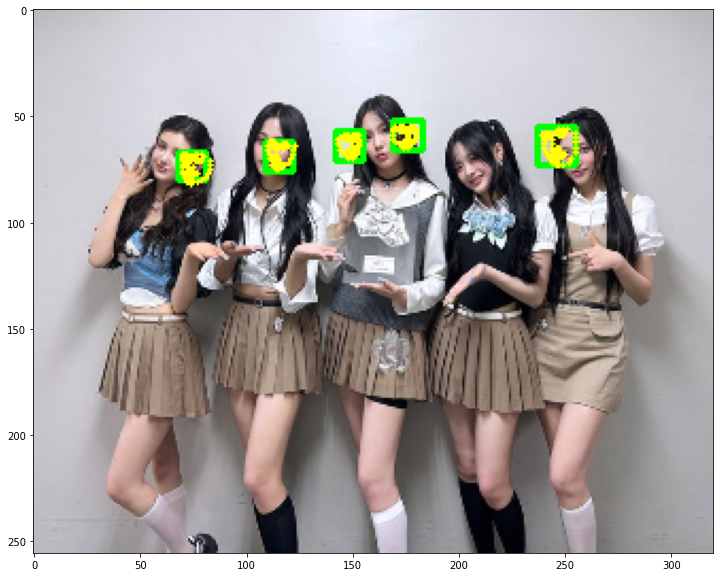
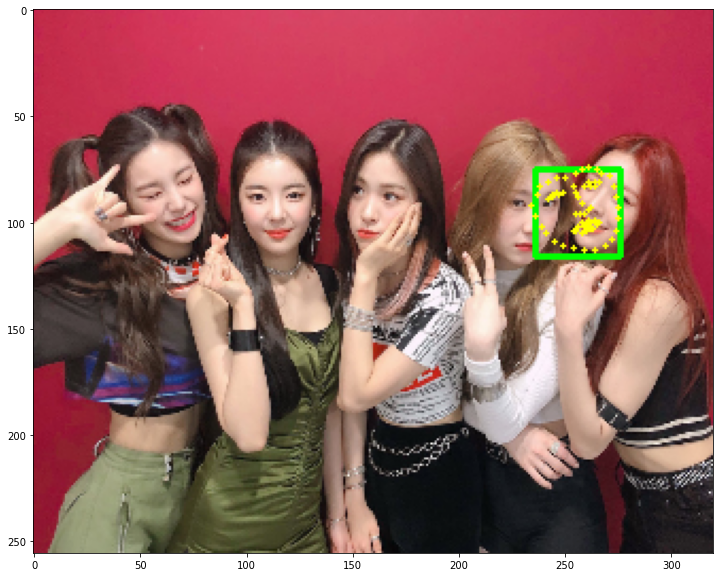
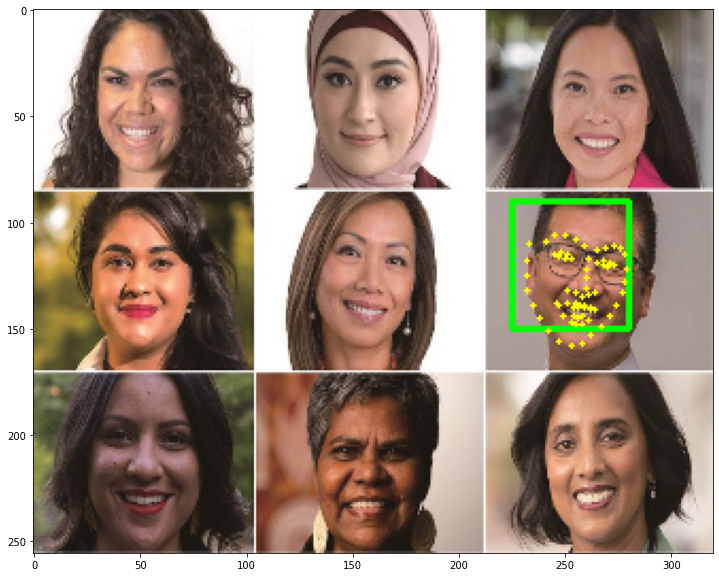

### 참고 이전 노드에서 dlib 의 detector_hog 결과
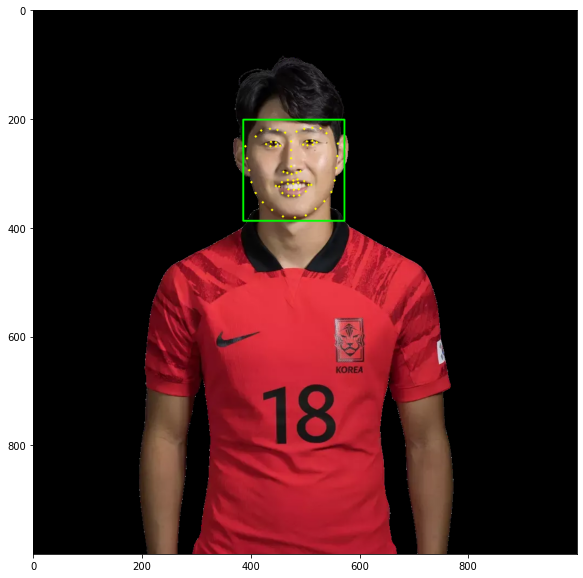
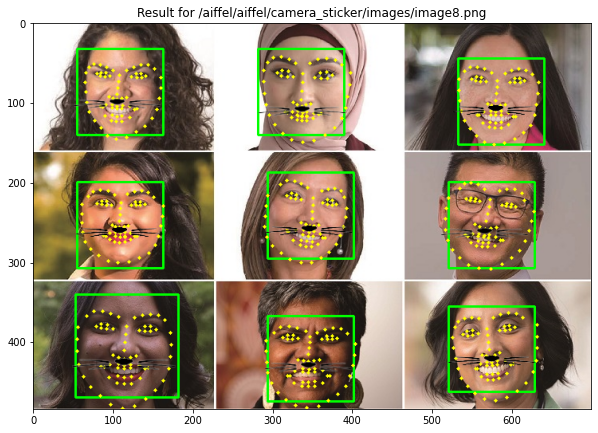

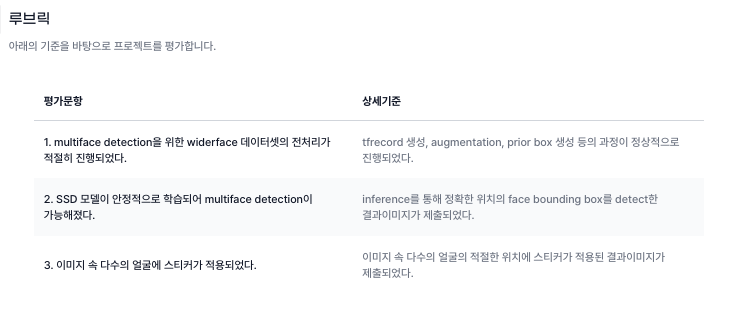